In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import harmonypy as hm
import importlib
import re

In [2]:
from sklearn import svm
from sklearn import metrics
from sklearn.metrics import plot_roc_curve, plot_precision_recall_curve
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

In [3]:
import degSummary
from scanpyColor import godsnot_102

In [4]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=600)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.2 numpy==1.20.3 scipy==1.5.3 pandas==1.3.5 scikit-learn==1.0.1 statsmodels==0.12.2 python-igraph==0.9.8 pynndescent==0.5.5


# Load data

In [5]:
os.chdir('../../..')

In [6]:
pwd

'/Users/tzuchiao/ProjectAnalysis/AFCA/script'

In [7]:
fcaH5adFolder='../FCA/dataset/h5ad'
fcaLoomFolder='../FCA/dataset/loom'

In [8]:
age_L=['5', '30', '50', '70']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [9]:
madNum=5
doubletTool='scrublet'

In [10]:
pwd

'/Users/tzuchiao/ProjectAnalysis/AFCA/script'

In [11]:
harmonyAnalysisFolder=f'Analysis/4.harmony'
dataFolder=f'{harmonyAnalysisFolder}/afcaFca_headBody_v0.5'

degCellnFolder=f'Analysis/5.deg_cellN'
os.makedirs(degCellnFolder, exist_ok=True)

degPicFolder=f'{degCellnFolder}/pic'
os.makedirs(degPicFolder, exist_ok=True)
umiGenenFolder=f'{degPicFolder}/umi_GeneN'
os.makedirs(umiGenenFolder, exist_ok=True)

makerFolder=f'{degCellnFolder}/marker'
os.makedirs(makerFolder, exist_ok=True)

ageDegFolder=f'{degCellnFolder}/ageDEG'
os.makedirs(ageDegFolder, exist_ok=True)

ageDeg5dFolder=f'{degCellnFolder}/ageDEG_d5'
os.makedirs(ageDeg5dFolder, exist_ok=True)

ageDegDynamicsFolder=f'{degCellnFolder}/ageDEG_dynamics'
os.makedirs(ageDegDynamicsFolder, exist_ok=True)

ageDegDynamicsGOFolder=f'{degCellnFolder}/GO_List'
os.makedirs(ageDegDynamicsGOFolder, exist_ok=True)

ageDegDynamicsGOAllGenes=f'{ageDegDynamicsGOFolder}/allCelltypes_ages'
os.makedirs(ageDegDynamicsGOAllGenes, exist_ok=True)

In [12]:
allHeadBodyDataFolder=f'{harmonyAnalysisFolder}/afcaFca_headBody_v1.0/normalizedCounts'

os.makedirs(allHeadBodyDataFolder, exist_ok=True)
allHeadBodyPicFolder=f'{allHeadBodyDataFolder}/pic'
os.makedirs(allHeadBodyPicFolder, exist_ok=True)

In [13]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure3Folder=f'{figureDataFolder}/Figure3'
os.makedirs(figure3Folder, exist_ok=True)
figure3PicFolder=f'{figure3Folder}/pic'
os.makedirs(figure3PicFolder, exist_ok=True)

In [14]:
ageDegFolder=f'{figure3Folder}/ageDEG'
os.makedirs(ageDegFolder, exist_ok=True)

ageDeg5dFolder=f'{figure3Folder}/ageDEG_compare5d'
os.makedirs(ageDeg5dFolder, exist_ok=True)

ageDegDynamicsFolder=f'{figure3Folder}/ageDEG_dynamics'
os.makedirs(ageDegDynamicsFolder, exist_ok=True)

sexDegFolder=f'{figure3Folder}/sexDeg'
os.makedirs(sexDegFolder, exist_ok=True)

In [15]:
cellnFolder=f'{figure2Folder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figure2Folder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [16]:
degSummaryFolder=f'{figure3Folder}/degSummary'
os.makedirs(degSummaryFolder, exist_ok=True)

In [17]:
highDeFolder=f'{figure3PicFolder}/highDE'
os.makedirs(highDeFolder, exist_ok=True)

In [18]:
goFolder=f'{figure3Folder}/GO_compareTo5d'
os.makedirs(goFolder, exist_ok=True)

goIdFolder=f'{goFolder}/geneID'
os.makedirs(goIdFolder, exist_ok=True)
goNameFolder=f'{goFolder}/geneName'
os.makedirs(goNameFolder, exist_ok=True)

In [19]:
revigoFolder=f'{figure3Folder}/revigo_compareTo5d'
os.makedirs(revigoFolder, exist_ok=True)

In [20]:
degBroadFolder=f'{figure3Folder}/degBroad'
os.makedirs(degBroadFolder, exist_ok=True)

degBroadSumFolder=f'{figure3Folder}/degBroadSummary'
os.makedirs(degBroadSumFolder, exist_ok=True)

goBroadFolder=f'{figure3Folder}/GO_broad_compareTo5d'
os.makedirs(goFolder, exist_ok=True)

goIdBroadFolder=f'{goBroadFolder}/geneID'
os.makedirs(goIdBroadFolder, exist_ok=True)
goNameBroadFolder=f'{goBroadFolder}/geneName'
os.makedirs(goNameBroadFolder, exist_ok=True)

revigoBroadFolder=f'{figure3Folder}/revigo_broad_compareTo5d'
os.makedirs(revigoBroadFolder, exist_ok=True)


# Figure 3A

In [20]:
adata_head=sc.read(f'{allHeadBodyDataFolder}/adata_head_S_v1.0.h5ad')
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_S_v1.0.h5ad')

In [100]:
adata_headBody=sc.read(f'{allHeadBodyDataFolder}/adata_headBody_S_v1.0.h5ad')

# GO

## Load GO files

### Load ontologies and associations

In [1]:
import goatools

In [2]:
goatools.__version__

'v1.2.3'

In [19]:
from goatools.obo_parser import GODag
from goatools.anno.gaf_reader import GafReader

obodag = GODag("../../Resource/GO/go-basic.obo")
ogaf = GafReader("../../Resource/GO/FlyBase_gene_association_09082022.gaf") # FlyBase file

../../Resource/GO/go-basic.obo: fmt(1.2) rel(2022-07-01) 47,008 Terms
HMS:0:00:02.051646 121,359 annotations READ: ../../Resource/GO/FlyBase_gene_association_09082022.gaf 


In [20]:
ns2assc = ogaf.get_ns2assc()

### Load Background gene set

In [21]:
geneid2symbol_Df=pd.read_table('cellrangerSummary/features.tsv', header=None, index_col=0)
geneid2symbol_Df.head()

,1,2
0,,
FBgn0267594,CR45932,Gene Expression
FBgn0259849,Su(Ste):CR42418,Gene Expression
FBgn0085494,Mst77Y-16Psi,Gene Expression
FBgn0085506,CG40635,Gene Expression
FBgn0259870,Su(Ste):CR42439,Gene Expression


In [22]:
geneid2symbol_D= dict(zip(geneid2symbol_Df.index.to_list(), geneid2symbol_Df[1].to_list()))

In [23]:
symbol2geneid_D= dict(zip(geneid2symbol_Df[1].to_list(), geneid2symbol_Df.index.to_list()))

### Initialize a GOEA object 

In [24]:
from goatools.goea.go_enrichment_ns import GOEnrichmentStudyNS

goeaobj = GOEnrichmentStudyNS(
        geneid2symbol_D, # List of fly protein-coding genes
        ns2assc, # geneid/GO associations
        obodag, # Ontologies
        propagate_counts = False,
        alpha = 0.05, # default significance cut-off
        methods = ['fdr_bh']) # defult multipletest correction method


Load BP Ontology Enrichment Analysis ...
 59% 10,305 of 17,562 population items found in association

Load CC Ontology Enrichment Analysis ...
 57%  9,955 of 17,562 population items found in association

Load MF Ontology Enrichment Analysis ...
 53%  9,302 of 17,562 population items found in association


## Load gene list

In [25]:
degLong_Df=pd.read_csv(f'{degSummaryFolder}/degLong_Df_compareTo5d.csv')
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()

In [26]:
degLong_Df

,names,pvals,adj,logfoldchanges,annotation,age
0,lncRNA:CR34335,6.029330e-25,9.642105e-21,-1.823522,16-cell germline cyst in germarium region 2a a...,70
1,ct,5.743381e-24,4.592408e-20,-33.383247,16-cell germline cyst in germarium region 2a a...,30
2,shot,3.133101e-24,4.592408e-20,-7.170534,16-cell germline cyst in germarium region 2a a...,30
3,RpL10Ab,1.954827e-23,1.563080e-19,-2.540619,16-cell germline cyst in germarium region 2a a...,70
4,Pdp1,3.517935e-23,1.875294e-19,-5.615617,16-cell germline cyst in germarium region 2a a...,30
...,...,...,...,...,...,...
164963,CG12374,1.183621e-03,4.968102e-02,-2.266295,visceral muscle of the midgut,30
164964,tx,1.191235e-03,4.986973e-02,-1.176143,visceral muscle of the midgut,30
164965,cype,1.195408e-03,4.991374e-02,-1.547477,visceral muscle of the midgut,30
164966,spen,1.201692e-03,4.991547e-02,0.197311,visceral muscle of the midgut,30


In [27]:
degLong_Df.age.value_counts()

70    59499
50    56765
30    48704
Name: age, dtype: int64

In [28]:
degLong_Df.age = degLong_Df.age.astype(str)

In [30]:
for cellType in celltypeN500_L[:]:
    print(cellType)
    
    cellTypeFileName='_'.join(cellType.split('/'))
    
    cellTypeDeg_Df=degLong_Df[degLong_Df.annotation == cellType]
    
    for age in age_L[1:]:
        # print(age)
        
        ageDeg_Df = cellTypeDeg_Df[cellTypeDeg_Df.age == age]
        # print(ageDeg_Df)
            
        upGenes_Df= ageDeg_Df[ageDeg_Df.logfoldchanges > 0]
        downGenes_Df= ageDeg_Df[ageDeg_Df.logfoldchanges < 0]

        allID_L=[symbol2geneid_D[x] for x in ageDeg_Df['names']]
        upId_L=[symbol2geneid_D[x] for x in upGenes_Df['names']]
        downId_L=[symbol2geneid_D[x] for x in downGenes_Df['names']]

        id_D=dict(zip(['all', 'up', 'down'], [allID_L, upId_L, downId_L]))
        for group in id_D.keys():
            geneids_study = id_D[group]
            goea_results_all = goeaobj.run_study(geneids_study)
            goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < 0.05]

            goeaobj.wr_tsv(f"{goNameFolder}/{cellTypeFileName}_{group}_{age}_symbols.tsv", goea_results_sig, itemid2name=geneid2symbol_D)
            goeaobj.wr_tsv(f"{goIdFolder}/{cellTypeFileName}_{group}_{age}_geneids.tsv", goea_results_sig)

16-cell germline cyst in germarium region 2a and 2b

Runing BP Ontology Analysis: current study set of 460 IDs.
 87%    401 of    460 study items found in association
100%    460 of    460 study items found in population(17562)
Calculating 5,170 uncorrected p-values using fisher_scipy_stats
   5,170 terms are associated with 10,305 of 17,562 population items
   1,247 terms are associated with    401 of    460 study items
  METHOD fdr_bh:
      55 GO terms found significant (< 0.05=alpha) ( 55 enriched +   0 purified): statsmodels fdr_bh
     269 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Runing CC Ontology Analysis: current study set of 460 IDs.
 85%    390 of    460 study items found in association
100%    460 of    460 study items found in population(17562)
Calculating 1,094 uncorrected p-values using fisher_scipy_stats
   1,094 terms are associated with  9,955 of 17,562 population items
     277 terms

## Revigo: remove redundant GOs

In [20]:
degLong_Df=pd.read_csv(f'{degSummaryFolder}/degLong_Df_compareTo5d.csv')
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()

### Collect all GO

In [21]:
allGoConcat_Df=pd.DataFrame(columns=['# GO', 'p_fdr_bh', 'name', 'annotation', 'ageCompare'])
upGoConcat_Df=pd.DataFrame(columns=['# GO', 'p_fdr_bh', 'name', 'annotation', 'ageCompare'])
downGoConcat_Df=pd.DataFrame(columns=['# GO', 'p_fdr_bh', 'name', 'annotation', 'ageCompare'])

for cellType in celltypeN500_L[:]:
    # print(cellType)
    cellTypeFileName='_'.join(cellType.split('/'))
    
    for i, age in enumerate(age_L[:-1]):
        for group in ['all', 'up', 'down']:
            allGoFile= f"{goNameFolder}/{cellTypeFileName}_all_{age_L[i+1]}_symbols.tsv"
            upGoFile= f"{goNameFolder}/{cellTypeFileName}_up_{age_L[i+1]}_symbols.tsv"
            downGoFile=f"{goNameFolder}/{cellTypeFileName}_down_{age_L[i+1]}_symbols.tsv"

            if group == 'all':
                if os.path.exists(allGoFile): 
                    allGo_Df=pd.read_table(allGoFile)
                    allGo_Df=allGo_Df.iloc[:, [0, 9, 3]]
                    allGo_Df['annotation'] = cellType
                    allGo_Df['ageCompare'] = f'{age_L[i+1]}/{age_L[0]}'
                    allGoConcat_Df=pd.concat([allGoConcat_Df, allGo_Df])
            if group == 'up':
                if os.path.exists(upGoFile): 
                    upGo_Df=pd.read_table(upGoFile)
                    upGo_Df=upGo_Df.iloc[:, [0, 9, 3]]
                    upGo_Df['annotation'] = cellType
                    upGo_Df['ageCompare'] = f'{age_L[i+1]}/{age_L[0]}'
                    upGoConcat_Df=pd.concat([upGoConcat_Df, upGo_Df])
            
            if group == 'down':
                if os.path.exists(downGoFile): 
                    downGo_Df=pd.read_table(downGoFile)
                    downGo_Df=downGo_Df.iloc[:, [0, 9, 3]]
                    downGo_Df['annotation'] = cellType
                    downGo_Df['ageCompare'] = f'{age_L[i+1]}/{age_L[0]}'
                    downGoConcat_Df=pd.concat([downGoConcat_Df, downGo_Df])

            
allGoConcat_Df.reset_index(inplace=True)
upGoConcat_Df.reset_index(inplace=True)
downGoConcat_Df.reset_index(inplace=True)


16-cell germline cyst in germarium region 2a and 2b
Johnston organ neuron
Poxn neuron
T neuron T2
T neuron T2a
T neuron T3
T neuron T4/T5
T neuron T4/T5a-b
T neuron T4/T5c-d
adult alary muscle
adult brain cell body glial cell
adult brain perineurial glial cell
adult differentiating enterocyte
adult fat body_body
adult fat body_head
adult glial cell
adult hindgut
adult lamina epithelial/marginal glial cell
adult midgut-hindgut hybrid zone
adult oenocyte
adult optic chiasma glial cell
adult peripheral nervous system
adult reticular neuropil associated glial cell_body
adult reticular neuropil associated glial cell_head
adult salivary gland
adult tracheal cell
adult ventral nervous system
alpha'/beta' Kenyon cell
alpha/beta Kenyon cell
auditory sensory neuron
cardia (1)
cell body glial cell
centrifugal neuron C2
centrifugal neuron C3
columnar neuron T1
cone cell
crop
distal medullary amacrine neuron Dm10
distal medullary amacrine neuron Dm3
distal medullary amacrine neuron Dm8
distal medul

In [22]:
allGoConcat_Df.drop('index', axis=1, inplace=True)
upGoConcat_Df.drop('index', axis=1, inplace=True)
downGoConcat_Df.drop('index', axis=1, inplace=True)

In [152]:
allGoConcat_Df['MinusLogFdr']=-np.log10(allGoConcat_Df.p_fdr_bh)
allGoConcat_Df['goName']=allGoConcat_Df['# GO'] +'_'+ allGoConcat_Df.name

upGoConcat_Df['MinusLogFdr']=-np.log10(upGoConcat_Df.p_fdr_bh)
upGoConcat_Df['goName']=upGoConcat_Df['# GO'] +'_'+ upGoConcat_Df.name

downGoConcat_Df['MinusLogFdr']=-np.log10(downGoConcat_Df.p_fdr_bh)
downGoConcat_Df['goName']=downGoConcat_Df['# GO'] +'_'+ downGoConcat_Df.name

In [153]:
allGoConcat_Df.to_csv(f'{goFolder}/allGoConcat_Df_compareTo5d.csv', index=False)
upGoConcat_Df.to_csv(f'{goFolder}/upGoConcat_Df_compareTo5d.csv', index=False)
downGoConcat_Df.to_csv(f'{goFolder}/downGoConcat_Df_compareTo5d.csv', index=False)

**Parse GOs with lowest fdr**

In [95]:
lowestGo_Df=pd.DataFrame(columns=allGoConcat_Df.columns.to_list()) # columns=allGoConcat_Df.columns.to_list(), index=range(len(allGoConcat_Df['# GO'].value_counts().index))
for i, go in enumerate(allGoConcat_Df['# GO'].value_counts().index):
    # print(go)
    df=allGoConcat_Df[allGoConcat_Df['# GO'] == go].sort_values(by='p_fdr_bh').reset_index().iloc[:1,:] # .iloc[0,:]
    # print(df)
    
    lowestGo_Df=pd.concat([lowestGo_Df, df])
    
    # if len(lowestGo_Df) == 0:
    #     lowestGo_Df=df
    # else:
    #     lowestGo_Df=pd.concat([lowestGo_Df, df])
    # #lowestGo_Df.iloc[i] = 
    
    
lowestGo_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName,index
0,GO:0002181,5.376380e-101,cytoplasmic translation,female reproductive system,70/5,100.269510,GO:0002181_cytoplasmic translation,193.0
0,GO:0048813,7.348047e-08,dendrite morphogenesis,muscle cell,70/5,7.133828,GO:0048813_dendrite morphogenesis,946.0
0,GO:0042773,7.924345e-03,ATP synthesis coupled electron transport,muscle cell,50/5,2.101037,GO:0042773_ATP synthesis coupled electron tran...,750.0
0,GO:0015990,7.924345e-03,electron transport coupled proton transport,muscle cell,50/5,2.101037,GO:0015990_electron transport coupled proton t...,753.0
0,GO:0022626,9.681755e-64,cytosolic ribosome,female reproductive system,70/5,63.014046,GO:0022626_cytosolic ribosome,243.0
...,...,...,...,...,...,...,...,...
0,GO:0008307,3.447751e-03,structural constituent of muscle,muscle cell,30/5,2.462464,GO:0008307_structural constituent of muscle,641.0
0,GO:0016887,8.600379e-03,ATP hydrolysis activity,muscle cell,30/5,2.065482,GO:0016887_ATP hydrolysis activity,648.0
0,GO:0000287,1.671853e-02,magnesium ion binding,muscle cell,30/5,1.776802,GO:0000287_magnesium ion binding,651.0
0,GO:0031386,3.719630e-02,protein tag,muscle cell,30/5,1.429500,GO:0031386_protein tag,653.0


In [24]:
lowestGo_Df.to_csv(f'{revigoFolder}/frdLowest.csv', index=False)

In [25]:
allGoConcat_Df[allGoConcat_Df['# GO'] == 'GO:0030036'].sort_values(by='p_fdr_bh').reset_index().iloc[:1,:] # .reset_index().iloc[0].p_fdr_bh

,index,# GO,p_fdr_bh,name,annotation,ageCompare
0,35391,GO:0030036,1.491470e-23,actin cytoskeleton organization,outer photoreceptor cell,70/5


In [1]:
# allGoConcatMin_Df

# # for group in []:
# for goNum in allGoConcat_Df['# GO'].value_counts().index:
#     print(allGoConcat_Df[allGoConcat_Df['# GO'] == goNum].sort_values(by='p_fdr_bh')) # .iloc[0]

## Plot non-redundant GOs

### import revioGO data

In [20]:
from matplotlib.colors import LogNorm, Normalize

In [20]:
allGoConcat_Df=pd.read_csv(f'{goFolder}/allGoConcat_Df_compareTo5d.csv')
upGoConcat_Df=pd.read_csv(f'{goFolder}/upGoConcat_Df_compareTo5d.csv')
downGoConcat_Df=pd.read_csv(f'{goFolder}/downGoConcat_Df_compareTo5d.csv')

In [21]:
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()

In [22]:
revigo_Df = pd.read_table(f'{revigoFolder}/frdLowest_Revigo.tsv')
revigo_Df[:20]

,TermID,Name,Value,LogSize,Frequency,Uniqueness,Dispensability,PC_0,PC_1,PC3_0,PC3_1,PC3_2,Representative
0,GO:0000028,ribosomal small subunit assembly,-7.899629,1.380211,0.199065,0.908559,0.512718,-4.702703,5.519749,0.321488,2.894628,-6.131542,NaN
1,GO:0000027,ribosomal large subunit assembly,-4.469800,1.230449,0.138480,0.911043,0.849870,NaN,NaN,NaN,NaN,NaN,28.0
2,GO:0000462,maturation of SSU-rRNA from tricistronic rRNA ...,-2.699669,1.544068,0.294270,0.894350,0.855142,NaN,NaN,NaN,NaN,NaN,28.0
3,GO:0000132,establishment of mitotic spindle orientation,-4.602060,1.361728,0.190410,0.833863,0.696953,-2.287987,5.536531,1.093702,5.222240,-2.801199,NaN
4,GO:0000022,mitotic spindle elongation,-2.746082,1.146128,0.112515,0.902511,0.745231,NaN,NaN,NaN,NaN,NaN,132.0
5,GO:0007052,mitotic spindle organization,-1.606155,1.826075,0.571231,0.893167,0.851171,NaN,NaN,NaN,NaN,NaN,132.0
6,GO:0040001,establishment of mitotic spindle localization,-1.473556,1.462398,0.242340,0.844593,0.960032,NaN,NaN,NaN,NaN,NaN,132.0
7,GO:0051294,establishment of spindle orientation,-2.912200,1.462398,0.242340,0.832327,0.941188,NaN,NaN,NaN,NaN,NaN,132.0
8,GO:0098813,nuclear chromosome segregation,-1.554683,2.173186,1.280942,0.959441,0.745808,NaN,NaN,NaN,NaN,NaN,132.0
9,GO:0000165,MAPK cascade,-2.971591,1.568202,0.311580,0.856210,0.620102,-0.451487,-6.367178,-1.365478,-5.616441,-1.938634,NaN


In [23]:
nonRedundantGo_Df=revigo_Df[revigo_Df.Representative.isna()]
nonRedundantGo_Df

,TermID,Name,Value,LogSize,Frequency,Uniqueness,Dispensability,PC_0,PC_1,PC3_0,PC3_1,PC3_2,Representative
0,GO:0000028,ribosomal small subunit assembly,-7.899629,1.380211,0.199065,0.908559,0.512718,-4.702703,5.519749,0.321488,2.894628,-6.131542,NaN
3,GO:0000132,establishment of mitotic spindle orientation,-4.602060,1.361728,0.190410,0.833863,0.696953,-2.287987,5.536531,1.093702,5.222240,-2.801199,NaN
9,GO:0000165,MAPK cascade,-2.971591,1.568202,0.311580,0.856210,0.620102,-0.451487,-6.367178,-1.365478,-5.616441,-1.938634,NaN
10,GO:0000209,protein polyubiquitination,-8.987163,2.008600,0.874156,0.939781,0.469750,4.951381,3.196695,-4.893275,2.766891,-1.867523,NaN
12,GO:0000278,mitotic cell cycle,-4.935542,2.602060,3.453349,0.957330,0.035002,-7.080085,5.125583,2.060454,-0.747980,-7.587518,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,GO:2000683,regulation of cellular response to X-ray,-1.303071,0.698970,0.034620,0.913744,0.277990,5.580822,-4.085848,1.784990,-2.227651,6.319571,NaN
1436,GO:2000737,negative regulation of stem cell differentiation,-3.930125,1.079181,0.095205,0.878635,0.511162,2.741846,-3.311393,0.708459,-4.868670,4.467591,NaN
1445,GO:2000767,positive regulation of cytoplasmic translation,-3.132840,0.698970,0.034620,0.891286,0.650858,4.581901,-2.537100,-3.635222,-1.728993,4.071446,NaN
1447,GO:2000779,regulation of double-strand break repair,-1.938279,0.903090,0.060585,0.890996,0.661847,4.404586,-4.276433,-1.557929,-3.156817,4.931500,NaN


In [24]:
revigoNonRedundantGo_L=nonRedundantGo_Df.TermID.to_list()

### up-regulated GOs

In [25]:
goConcatRevigo_Df=upGoConcat_Df[upGoConcat_Df['# GO'].isin(revigoNonRedundantGo_L)]
goConcatRevigo_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
8,GO:0007476,0.000001,imaginal disc-derived wing morphogenesis,16-cell germline cyst in germarium region 2a a...,70/5,5.867738,GO:0007476_imaginal disc-derived wing morphoge...
10,GO:0007379,0.000565,segment specification,16-cell germline cyst in germarium region 2a a...,70/5,3.247934,GO:0007379_segment specification
12,GO:0045944,0.001402,positive regulation of transcription by RNA po...,16-cell germline cyst in germarium region 2a a...,70/5,2.853271,GO:0045944_positive regulation of transcriptio...
19,GO:0006357,0.005994,regulation of transcription by RNA polymerase II,16-cell germline cyst in germarium region 2a a...,70/5,2.222260,GO:0006357_regulation of transcription by RNA ...
20,GO:0045880,0.007685,positive regulation of smoothened signaling pa...,16-cell germline cyst in germarium region 2a a...,70/5,2.114338,GO:0045880_positive regulation of smoothened s...
...,...,...,...,...,...,...,...
29118,GO:0042220,0.048805,response to cocaine,visceral muscle of the midgut,30/5,1.311536,GO:0042220_response to cocaine
29131,GO:0006357,0.017376,regulation of transcription by RNA polymerase II,visceral muscle of the midgut,50/5,1.760045,GO:0006357_regulation of transcription by RNA ...
29139,GO:0006357,0.003298,regulation of transcription by RNA polymerase II,visceral muscle of the midgut,70/5,2.481720,GO:0006357_regulation of transcription by RNA ...
29140,GO:0000381,0.007365,"regulation of alternative mRNA splicing, via s...",visceral muscle of the midgut,70/5,2.132837,GO:0000381_regulation of alternative mRNA spli...


In [26]:
goConcatRevigo_Df_30d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '30/5']
goConcatRevigo_Df_50d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '50/5']
goConcatRevigo_Df_70d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '70/5']

#### **50d/5d**

In [27]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [28]:
goN=20

topGO_L=[]

goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)

for i, goName in enumerate(goConcatRevigo_Df_50d.goName):
    if len(topGO_L) <goN:
        if goName not in topGO_L: topGO_L.append(goName)

goMtxTop_50d=goMtx_50d.loc[:,goMtx_50d.loc['sumGeneGo'] != 0]

goMtxTop_50d=goMtx_50d.loc[goMtx_50d.index.isin(topGO_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [119]:
# goMtxTop_50d=goMtx_50d.loc[:,goMtx_50d.loc['sumGeneGo'] != 0]
# goMtxTop_50d=goMtx_50d.loc[goMtx_50d.index.isin(topGO_L)]
# goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
# goMtxTop_50d

,Johnston organ neuron,T neuron T2,T neuron T2a,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,adult brain cell body glial cell,adult brain perineurial glial cell,adult differentiating enterocyte,...,subperineurial glial cell_body,subperineurial glial cell_head,transmedullary Y neuron TmY14,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm3a,transmedullary neuron Tm4,visceral muscle of the midgut
GO:0007411_axon guidance,24.509498,0.000000,0.000000,0.000000,8.111483,4.387224,0.000000,6.667740,21.362539,11.615689,...,6.484233,28.675954,0.000000,3.438386,0.000000,6.496532,6.30654,6.219236,3.467354,0.000000
GO:0006357_regulation of transcription by RNA polymerase II,7.520250,0.000000,0.000000,0.000000,0.000000,0.000000,6.441421,4.024895,25.901908,3.550330,...,3.419126,11.008527,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,4.052653
GO:0007476_imaginal disc-derived wing morphogenesis,5.203492,0.000000,0.000000,0.000000,3.572573,0.000000,0.000000,5.134827,27.647805,6.205325,...,3.020632,8.358323,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
GO:0006468_protein phosphorylation,7.420556,0.000000,0.000000,0.000000,0.000000,0.000000,3.020353,11.550727,21.552422,0.000000,...,0.000000,8.412856,0.000000,0.000000,0.000000,0.000000,0.00000,4.385721,0.000000,0.000000
GO:0007165_signal transduction,5.529419,4.393835,8.745633,6.722967,0.000000,0.000000,0.000000,0.000000,3.155983,0.000000,...,0.000000,0.000000,5.467152,0.000000,4.725139,11.417360,0.00000,4.151640,0.000000,0.000000
GO:0007268_chemical synaptic transmission,12.632940,0.000000,8.879548,4.251064,0.000000,0.000000,4.521342,0.000000,0.000000,0.000000,...,0.000000,3.504656,3.038878,0.000000,4.725139,8.066121,0.00000,0.000000,0.000000,0.000000
GO:0035556_intracellular signal transduction,4.127606,0.000000,0.000000,0.000000,0.000000,3.036460,0.000000,6.667740,5.381717,0.000000,...,0.000000,3.237719,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
GO:0045944_positive regulation of transcription by RNA polymerase II,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.851266,0.000000,13.450098,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
GO:0007391_dorsal closure,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.763255,13.495150,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
GO:0098609_cell-cell adhesion,8.490394,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,13.621330,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000


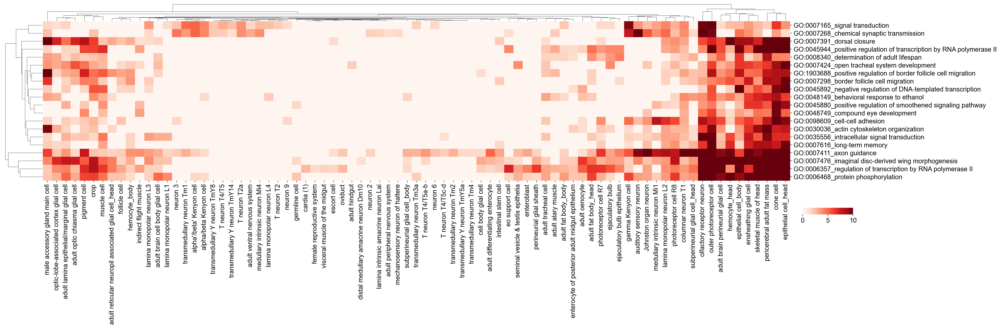

In [29]:
with rc_context({'figure.figsize': (40, 30)}):
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d,  figsize=(30, 10), xticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10)
    ax.ax_cbar.set_position((0.80, .35, .05, .02))
    plt.savefig(f'{goFolder}/heatmap_GO_up_top{goN}_50d_5d.pdf')

### up-regulated GOs: Use top 10 GOs from each cell type

**50d/5d**

In [69]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [65]:
# goN=5
# topGO_eachCelltype_L=[]

# goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
# goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

# goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

# goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)

# # for i, goName in enumerate(goConcatRevigo_Df_30d.goName):
# #     if len(top10GO_L) <=20:
# #         if goName not in top10GO_L: top10GO_L.append(goName)

# for cellType in goMtx_50d.columns:
#     # print(cellType)
#     cellType_mtx=goMtx_50d[:-1]
#     cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
#     # print(cellType_mtx.index)
#     cellType10Go_L=cellType_mtx.index.to_list()[:10]
    
#     if len(cellType10Go_L) != 0:
#         for i, go in enumerate(cellType10Go_L):
#             if goMtx_50d.loc[go, cellType] != 0:
#                 if go not in topGO_eachCelltype_L: topGO_eachCelltype_L.append(go)

# goMtxTop_50d=goMtx_50d.loc[:,goMtx_50d.loc['sumGeneGo'] != 0]
# goMtxTop_50d=goMtx_50d.loc[goMtx_50d.index.isin(topGO_eachCelltype_L)]
# goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
# # goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [70]:
goN=5
topGO_eachCelltype_L=[]
topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d.iloc[:,:]
# goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


for cellType in goMtxTop_50d.columns:
    # print(cellType)
    
    cellType_mtx=pd.DataFrame(goMtxTop_50d.loc[:,cellType])
    cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
    cellTypeTopGo_L=cellType_mtx.index.to_list()[:goN]
    # print(cellTypeTopGo_L)
    if len(cellTypeTopGo_L) != 0:
        for i, go in enumerate(cellTypeTopGo_L):
            if goMtxTop_50d.loc[go, cellType] != 0:
                if cellType in topGO_eachCelltype_D.keys(): topGO_eachCelltype_D[cellType].append(go)
                if cellType not in topGO_eachCelltype_D.keys():
                    topGO_eachCelltype_D[cellType] = [go]

                if go not in topGO_eachCelltype_L: 
                    topGO_eachCelltype_L.append(go)
                    


goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_eachCelltype_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
goMtxTop_50d

,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,adult brain cell body glial cell,...,subperineurial glial cell_head,transmedullary Y neuron TmY14,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,visceral muscle of the midgut
GO:0007411_axon guidance,10.64434,0,0,0,0,0,3.522772,1.905347,0,2.895763,...,12.453809,0,1.493272,0,2.821408,2.738896,0,2.70098,1.505853,0
GO:0006357_regulation of transcription by RNA polymerase II,3.266003,0,0,0,0,0,0,0,2.797474,1.74799,...,4.780943,0,0,0,0,0,0,0,0,1.760045
GO:0007476_imaginal disc-derived wing morphogenesis,2.259848,0,0,0,0,0,1.551549,0,0,2.230027,...,3.629974,0,0,0,0,0,0,0,0,0
GO:0006468_protein phosphorylation,3.222707,0,0,0,0,0,0,0,1.311723,5.016417,...,3.653657,0,0,0,0,0,0,1.904694,0,0
GO:0007165_signal transduction,2.401396,0,1.908218,3.79818,0,2.919747,0,0,0,0,...,0,2.374354,0,2.052102,4.958497,0,0,1.803034,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0006936_muscle contraction,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GO:0045752_positive regulation of Toll signaling pathway,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GO:0060278_regulation of ovulation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GO:0043052_thermotaxis,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [71]:
goMtx_50d.index = [x.split('_')[-1] for x in goMtx_50d.index]
goMtxTop_50d.index = [x.split('_')[-1] for x in goMtxTop_50d.index]

In [72]:
selectCellType_L=['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']
goMtxTop_50d_s = goMtxTop_50d.loc[:, selectCellType_L]

goMtxTop_50d_s

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
axon guidance,10.167266,22.254417,19.413498,6.151904,3.886677,1.791602
regulation of transcription by RNA polymerase II,16.781988,15.748909,14.957145,1.94901,3.337403,2.678879
imaginal disc-derived wing morphogenesis,23.559989,21.983387,17.616589,4.073039,0,1.916565
protein phosphorylation,18.151806,12.798523,12.035792,2.037932,0,3.468624
signal transduction,1.837192,10.600581,6.521402,1.599738,0,2.072491
...,...,...,...,...,...,...
muscle contraction,0,0,0,0,3.337403,0
positive regulation of Toll signaling pathway,1.348732,0,0,0,0,0
regulation of ovulation,0,0,0,0,0,0
thermotaxis,0,0,0,0,0,0


In [74]:
selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
for cellType in selectCellType_L:
    if cellType in topGO_eachCelltype_D.keys():
        for go in topGO_eachCelltype_D[cellType]:
            go=go.split('_')[-1]
            if go not in selectedGo_L: 
                selectedGo_L.append(go)
    

selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L), selectCellType_L] # 

# selectCellType_L
# selectMtx_50d=goMtxTop_50d_s.loc[selectedGo_L, :]

# selectMtx_50d=selectMtx_50d.loc[:, selectMtx_50d.sum(axis=0) != 0]

selectMtx_50d

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
axon guidance,10.167266,22.254417,19.413498,6.151904,3.886677,1.791602
regulation of transcription by RNA polymerase II,16.781988,15.748909,14.957145,1.94901,3.337403,2.678879
imaginal disc-derived wing morphogenesis,23.559989,21.983387,17.616589,4.073039,0,1.916565
protein phosphorylation,18.151806,12.798523,12.035792,2.037932,0,3.468624
positive regulation of transcription by RNA polymerase II,14.694445,10.360166,12.027482,1.7801,3.232622,1.498885
dorsal closure,10.628413,7.053054,10.723855,10.792299,1.326143,0
positive regulation of border follicle cell migration,7.779642,8.204186,8.348501,9.977905,0,0
cell-cell adhesion,7.789076,7.053054,12.090774,1.632757,0,0
actin cytoskeleton organization,11.599004,9.385414,7.266489,9.629082,0,0
border follicle cell migration,8.739685,4.095786,8.348501,6.596427,0,0


In [76]:
selectMtx_50d=selectMtx_50d.astype(float)

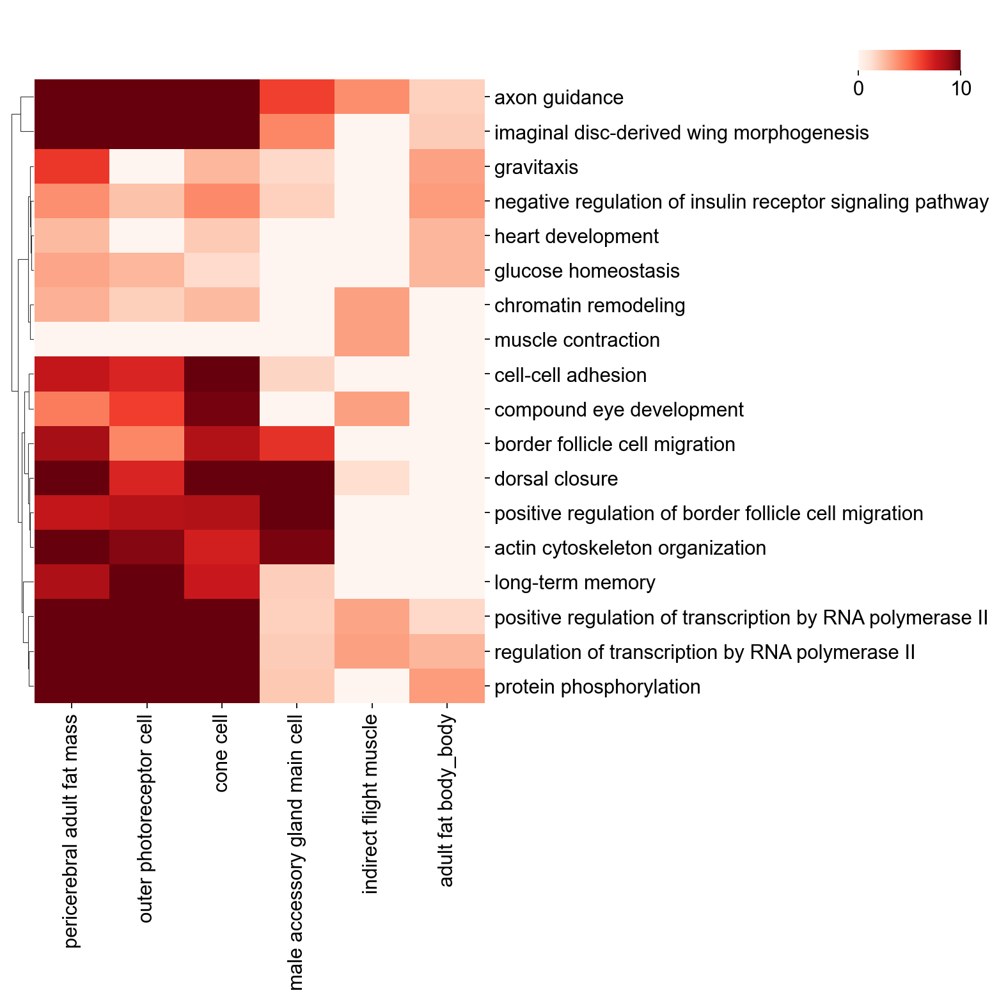

In [79]:
kws = dict(cbar_kws=dict(orientation='horizontal'))
ax=sns.clustermap(selectMtx_50d, figsize=(10,10), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10, col_cluster=False)
ax.ax_cbar.set_position((0.85, .92, .1, .02))
# plt.savefig(f'{goFolder}/heatmap_GO_up_eachCelltype_top{goN}_30d_5d.pdf')

### up-regulated GOs: Check distribution of GO frequency

In [29]:
goConcatRevigo_Df_50d

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
12532,GO:0007476,2.065642e-27,imaginal disc-derived wing morphogenesis,epithelial cell_head,50/5,26.684945,GO:0007476_imaginal disc-derived wing morphoge...
20874,GO:0007411,9.220711e-25,axon guidance,olfactory receptor neuron,50/5,24.035236,GO:0007411_axon guidance
24053,GO:0007476,2.754300e-24,imaginal disc-derived wing morphogenesis,pericerebral adult fat mass,50/5,23.559989,GO:0007476_imaginal disc-derived wing morphoge...
12533,GO:0006357,1.641561e-23,regulation of transcription by RNA polymerase II,epithelial cell_head,50/5,22.784743,GO:0006357_regulation of transcription by RNA ...
22196,GO:0007411,5.566509e-23,axon guidance,outer photoreceptor cell,50/5,22.254417,GO:0007411_axon guidance
...,...,...,...,...,...,...,...
9971,GO:0045464,4.980571e-02,R8 cell fate specification,ensheathing glial cell,50/5,1.302721,GO:0045464_R8 cell fate specification
27384,GO:0007294,4.988126e-02,germarium-derived oocyte fate determination,skeletal muscle of head,50/5,1.302063,GO:0007294_germarium-derived oocyte fate deter...
5164,GO:0016322,4.992302e-02,neuron remodeling,alpha'/beta' Kenyon cell,50/5,1.301699,GO:0016322_neuron remodeling
20559,GO:0007205,4.992319e-02,protein kinase C-activating G protein-coupled ...,neuron 2,50/5,1.301698,GO:0007205_protein kinase C-activating G prote...


In [30]:
goFrequency_Df = pd.DataFrame(goConcatRevigo_Df_50d.goName.value_counts())
goFrequency_Df.columns = ['counts']
goFrequency_Df.insert(0, 'goName', goFrequency_Df.index.to_list())
goFrequency_Df

,goName,counts
GO:0007411_axon guidance,GO:0007411_axon guidance,59
GO:0006357_regulation of transcription by RNA polymerase II,GO:0006357_regulation of transcription by RNA ...,51
GO:0007476_imaginal disc-derived wing morphogenesis,GO:0007476_imaginal disc-derived wing morphoge...,49
GO:0006468_protein phosphorylation,GO:0006468_protein phosphorylation,47
GO:0007165_signal transduction,GO:0007165_signal transduction,40
...,...,...
GO:0034446_substrate adhesion-dependent cell spreading,GO:0034446_substrate adhesion-dependent cell s...,1
GO:0043161_proteasome-mediated ubiquitin-dependent protein catabolic process,GO:0043161_proteasome-mediated ubiquitin-depen...,1
GO:0070884_regulation of calcineurin-NFAT signaling cascade,GO:0070884_regulation of calcineurin-NFAT sign...,1
"GO:0007384_specification of segmental identity, thorax",GO:0007384_specification of segmental identity...,1


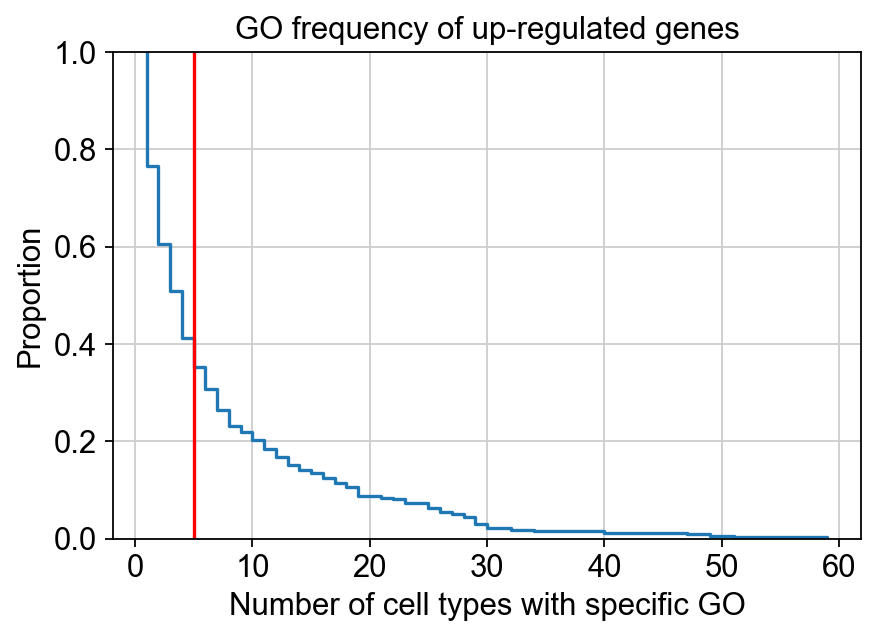

In [31]:
with rc_context({'figure.figsize': (6, 4)}):
    sns.ecdfplot(data=goFrequency_Df, x="counts", complementary=True)
    plt.xlabel('Number of cell types with specific GO')
    plt.axvline(5, color='red')
    plt.title('GO frequency of up-regulated genes')
    plt.savefig(f'{goFolder}/goFrequency_up.pdf')

In [32]:
goFrequency_Df[goFrequency_Df['counts'] > 5]

,goName,counts
GO:0007411_axon guidance,GO:0007411_axon guidance,59
GO:0006357_regulation of transcription by RNA polymerase II,GO:0006357_regulation of transcription by RNA ...,51
GO:0007476_imaginal disc-derived wing morphogenesis,GO:0007476_imaginal disc-derived wing morphoge...,49
GO:0006468_protein phosphorylation,GO:0006468_protein phosphorylation,47
GO:0007165_signal transduction,GO:0007165_signal transduction,40
...,...,...
GO:0007488_histoblast morphogenesis,GO:0007488_histoblast morphogenesis,6
GO:0007482_haltere development,GO:0007482_haltere development,6
GO:0060395_SMAD protein signal transduction,GO:0060395_SMAD protein signal transduction,6
GO:0097090_presynaptic membrane organization,GO:0097090_presynaptic membrane organization,6


In [33]:
goFrequency5_L=goFrequency_Df[goFrequency_Df['counts'] <= 5].goName.to_list()
goFrequencyHigh_L=goFrequency_Df[goFrequency_Df['counts'] > 5].goName.to_list()
goFrequency_D = dict(zip(goFrequency_Df.index.to_list(), goFrequency_Df.counts.to_list()))

In [34]:
go50d_count5_Df = goConcatRevigo_Df_50d[goConcatRevigo_Df_50d.goName.isin(goFrequency5_L)]
go50d_countHigh_Df = goConcatRevigo_Df_50d[~goConcatRevigo_Df_50d.goName.isin(goFrequency5_L)]
go50d_count5_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
24097,GO:0055088,0.000006,lipid homeostasis,pericerebral adult fat mass,50/5,5.259533,GO:0055088_lipid homeostasis
12588,GO:0060323,0.000024,head morphogenesis,epithelial cell_head,50/5,4.612732,GO:0060323_head morphogenesis
24110,GO:0070328,0.000062,triglyceride homeostasis,pericerebral adult fat mass,50/5,4.208659,GO:0070328_triglyceride homeostasis
12599,GO:0010888,0.000074,negative regulation of lipid storage,epithelial cell_head,50/5,4.133126,GO:0010888_negative regulation of lipid storage
28369,GO:0007412,0.000091,axon target recognition,subperineurial glial cell_head,50/5,4.042009,GO:0007412_axon target recognition
...,...,...,...,...,...,...,...
21078,GO:0048150,0.049626,behavioral response to ether,olfactory receptor neuron,50/5,1.304291,GO:0048150_behavioral response to ether
21076,GO:0045805,0.049626,positive regulation of eclosion,olfactory receptor neuron,50/5,1.304291,GO:0045805_positive regulation of eclosion
27384,GO:0007294,0.049881,germarium-derived oocyte fate determination,skeletal muscle of head,50/5,1.302063,GO:0007294_germarium-derived oocyte fate deter...
20559,GO:0007205,0.049923,protein kinase C-activating G protein-coupled ...,neuron 2,50/5,1.301698,GO:0007205_protein kinase C-activating G prote...


In [42]:
go50d_count5_Df.to_csv(f'{goFolder}/go50d_count5_Df_up.csv', index=False)
go50d_countHigh_Df.to_csv(f'{goFolder}/go50d_countHigh_Df_up.csv', index=False)
goFrequency_Df.to_csv(f'{goFolder}/goFrequency_Df_up.csv', index=False)

**50d/5d: within 5 GOs**

In [35]:
go50d_count5_Df=pd.read_csv(f'{goFolder}/go50d_count5_Df_up.csv')
go50d_countHigh_Df=pd.read_csv(f'{goFolder}/go50d_countHigh_Df_up.csv')
goFrequency_Df=pd.read_csv(f'{goFolder}/goFrequency_Df_up.csv')

In [36]:
go50d_count5_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,GO:0046928,0.001040,regulation of neurotransmitter secretion,Johnston organ neuron,50/5,2.982812,GO:0046928_regulation of neurotransmitter secr...
1,GO:0048150,0.019463,behavioral response to ether,Johnston organ neuron,50/5,1.710788,GO:0048150_behavioral response to ether
2,GO:0007605,0.030961,sensory perception of sound,Johnston organ neuron,50/5,1.509192,GO:0007605_sensory perception of sound
3,GO:0007500,0.042448,mesodermal cell fate determination,Johnston organ neuron,50/5,1.372140,GO:0007500_mesodermal cell fate determination
4,GO:0090136,0.042448,epithelial cell-cell adhesion,Johnston organ neuron,50/5,1.372140,GO:0090136_epithelial cell-cell adhesion
...,...,...,...,...,...,...,...
503,GO:0007412,0.000091,axon target recognition,subperineurial glial cell_head,50/5,4.042009,GO:0007412_axon target recognition
504,GO:0031290,0.024554,retinal ganglion cell axon guidance,subperineurial glial cell_head,50/5,1.609869,GO:0031290_retinal ganglion cell axon guidance
505,GO:0001941,0.042155,postsynaptic membrane organization,subperineurial glial cell_head,50/5,1.375147,GO:0001941_postsynaptic membrane organization
506,GO:0046928,0.047388,regulation of neurotransmitter secretion,transmedullary Y neuron TmY5a,50/5,1.324331,GO:0046928_regulation of neurotransmitter secr...


In [37]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [38]:
goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [39]:
goN=5
topGO_eachCelltype_L=[]
topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


for cellType in goMtxTop_50d.columns:
    # print(cellType)
    
    cellType_mtx=pd.DataFrame(goMtxTop_50d.loc[:,cellType])
    cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
    cellTypeTopGo_L=cellType_mtx.index.to_list()[:goN]
    # print(cellTypeTopGo_L)
    if len(cellTypeTopGo_L) != 0:
        for i, go in enumerate(cellTypeTopGo_L):
            if goMtxTop_50d.loc[go, cellType] != 0:
                if cellType in topGO_eachCelltype_D.keys(): topGO_eachCelltype_D[cellType].append(go)
                if cellType not in topGO_eachCelltype_D.keys():
                    topGO_eachCelltype_D[cellType] = [go]

                if go not in topGO_eachCelltype_L: 
                    topGO_eachCelltype_L.append(go)
                    


goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_eachCelltype_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,Johnston organ neuron,adult brain cell body glial cell,adult brain perineurial glial cell,adult fat body_body,adult fat body_head,adult lamina epithelial/marginal glial cell,adult optic chiasma glial cell,adult tracheal cell,adult ventral nervous system,alpha'/beta' Kenyon cell,...,outer photoreceptor cell,pericerebral adult fat mass,perineurial glial sheath,photoreceptor cell R7,photoreceptor cell R8,pigment cell,skeletal muscle of head,subperineurial glial cell_head,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8
GO:0040008_regulation of growth,0.000000,0.0,1.528371,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,1.837586,1.421410,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0
GO:0046928_regulation of neurotransmitter secretion,2.982812,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,2.342564,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,1.324331,0.0
GO:0055088_lipid homeostasis,0.000000,0.0,0.000000,1.791602,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,5.259533,0.0,0.0,0.000000,0.000000,1.632100,0.0,0.000000,0.0
GO:0045176_apical protein localization,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,1.360911,0.000000,0.000000,0.0,0.000000,0.0
GO:0007294_germarium-derived oocyte fate determination,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,1.373941,1.302063,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0007561_imaginal disc eversion,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0
GO:0000209_protein polyubiquitination,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,3.174475,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0
GO:0007458_progression of morphogenetic furrow involved in compound eye morphogenesis,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0
GO:0043161_proteasome-mediated ubiquitin-dependent protein catabolic process,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0


In [36]:
# goN=5
# topGO_eachCelltype_L=[]
# topGO_eachCelltype_D={}

# goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
# # goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
# goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

# goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
# goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


# for cellType in goMtxTop_50d.columns:
#     # print(cellType)
    
#     cellType_mtx=pd.DataFrame(goMtxTop_50d.loc[:,cellType])
#     cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
#     cellTypeTopGo_L=cellType_mtx.index.to_list()[:goN]
#     if len(cellTypeTopGo_L) != 0:
#         for i, go in enumerate(cellTypeTopGo_L):
#             if goMtxTop_50d.loc[go, cellType] != 0:
#                 if go not in topGO_eachCelltype_L: 
#                     topGO_eachCelltype_L.append(go)
                    
#                     if cellType not in topGO_eachCelltype_D.keys():
#                         topGO_eachCelltype_D[cellType] = [go]
#                     else: topGO_eachCelltype_D[cellType].append(go)

# goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_eachCelltype_L)]
# goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,Johnston organ neuron,adult brain cell body glial cell,adult brain perineurial glial cell,adult fat body_body,adult fat body_head,adult lamina epithelial/marginal glial cell,adult optic chiasma glial cell,adult tracheal cell,adult ventral nervous system,alpha'/beta' Kenyon cell,...,outer photoreceptor cell,pericerebral adult fat mass,perineurial glial sheath,photoreceptor cell R7,photoreceptor cell R8,pigment cell,skeletal muscle of head,subperineurial glial cell_head,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8
GO:0032880_regulation of protein localization,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.426252,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GO:0032968_positive regulation of transcription elongation by RNA polymerase II,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,2.495968,0.0,0.0,0.0,0.0,2.987167,0.0,0.0,0.0
GO:0007527_adult somatic muscle development,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0,2.035274,0.0,0.0,0.0
GO:0048865_stem cell fate commitment,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,1.639409,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GO:0042060_wound healing,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.619460,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0035080_heat shock-mediated polytene chromosome puffing,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GO:0007186_G protein-coupled receptor signaling pathway,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GO:0046528_imaginal disc fusion,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
GO:0007561_imaginal disc eversion,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0


In [40]:
goMtx_50d.index = [x.split('_')[-1] for x in goMtx_50d.index]
goMtxTop_50d.index = [x.split('_')[-1] for x in goMtxTop_50d.index]

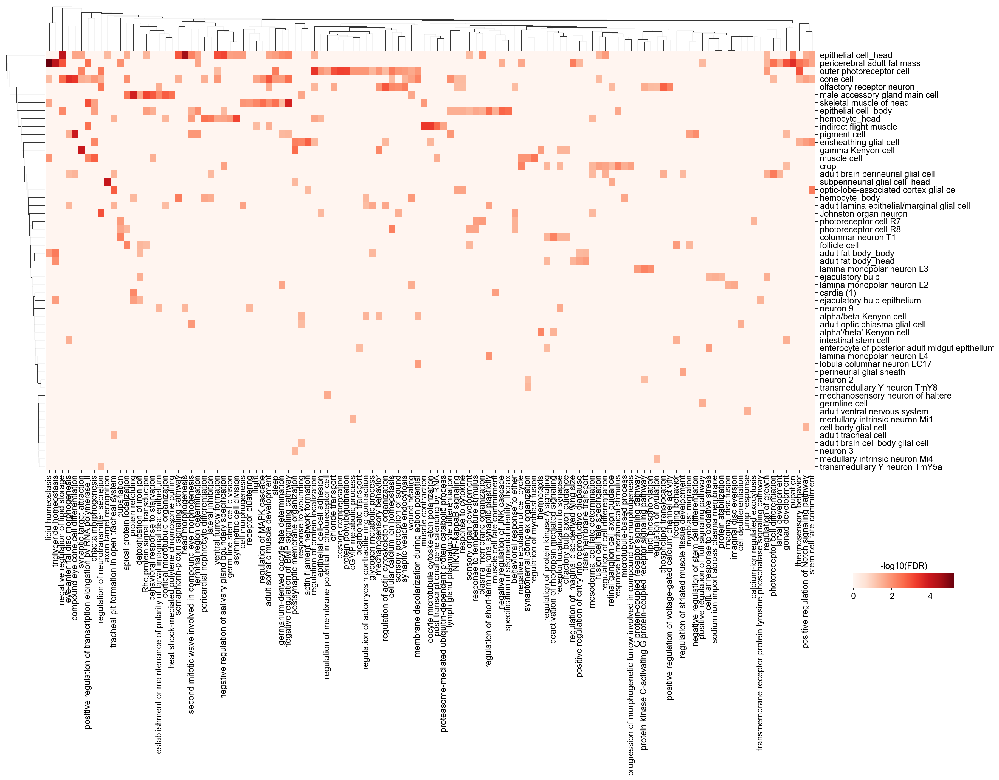

In [104]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d.transpose(), figsize=(23, 18), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws,) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.85, .25, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_up_eachCelltype_top{goN}_50d_5d.pdf')

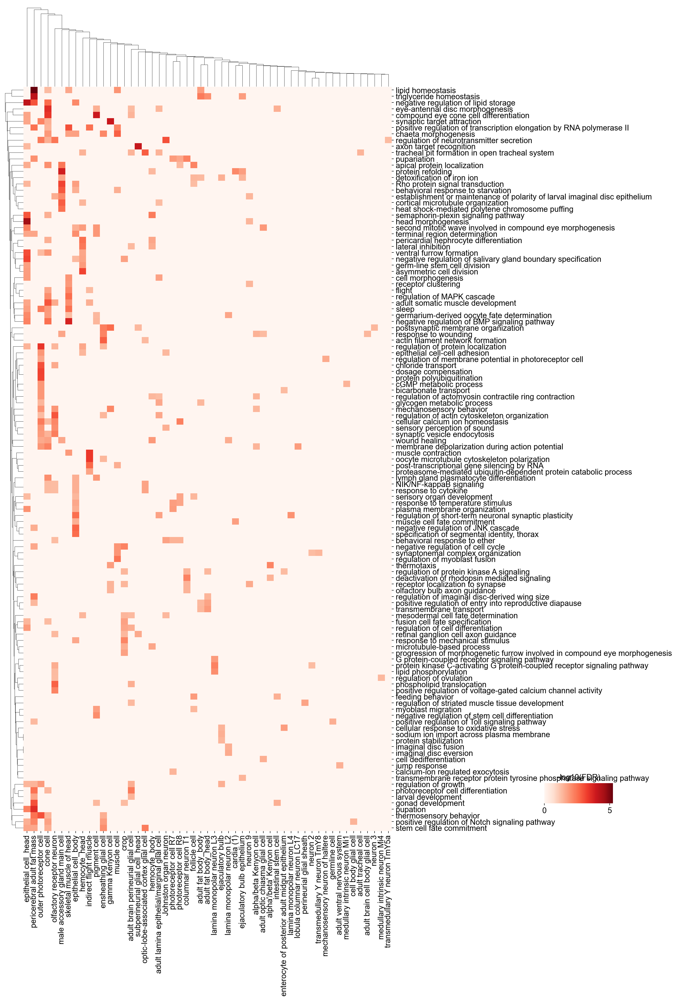

In [105]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(17, 25), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, ) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.8, .2, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_up_eachCelltype_top{goN}_50d_5d_vertical.pdf')

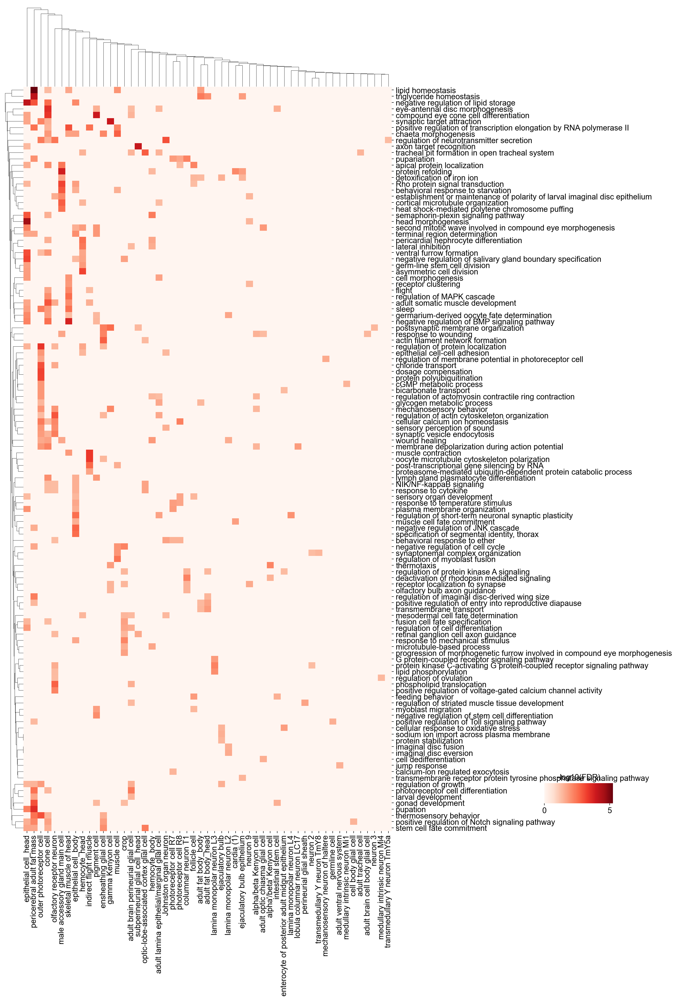

In [106]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(17, 25), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, ) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.8, .2, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_up_eachCelltype_top{goN}_50d_5d_vertical.pdf')

In [41]:
# selected_L=[ 'adult fat body_body', 'pericerebral adult fat mass', 'adult oenocyte', 'outer photoreceptor cell', 'cone cell',  'male accessory gland main cell', 'indirect flight muscle'] #
selected_L=['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell',  'indirect flight muscle', 'adult fat body_body', 'adult fat body_head']


selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
for cellType in selected_L:
    if cellType in topGO_eachCelltype_D.keys():
        for go in topGO_eachCelltype_D[cellType]:
            go=go.split('_')[-1]
            if go not in selectedGo_L: 
                selectedGo_L.append(go)
    

selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L), goMtxTop_50d.columns.isin(selected_L)]
selectMtx_50d=selectMtx_50d.loc[:, selectMtx_50d.sum(axis=0) != 0]

# selectMtx_50d

In [42]:
topGO_eachCelltype_D['male accessory gland main cell']

['GO:0042026_protein refolding',
 'GO:0007266_Rho protein signal transduction',
 'GO:0042595_behavioral response to starvation',
 'GO:0043622_cortical microtubule organization',
 'GO:0035080_heat shock-mediated polytene chromosome puffing']

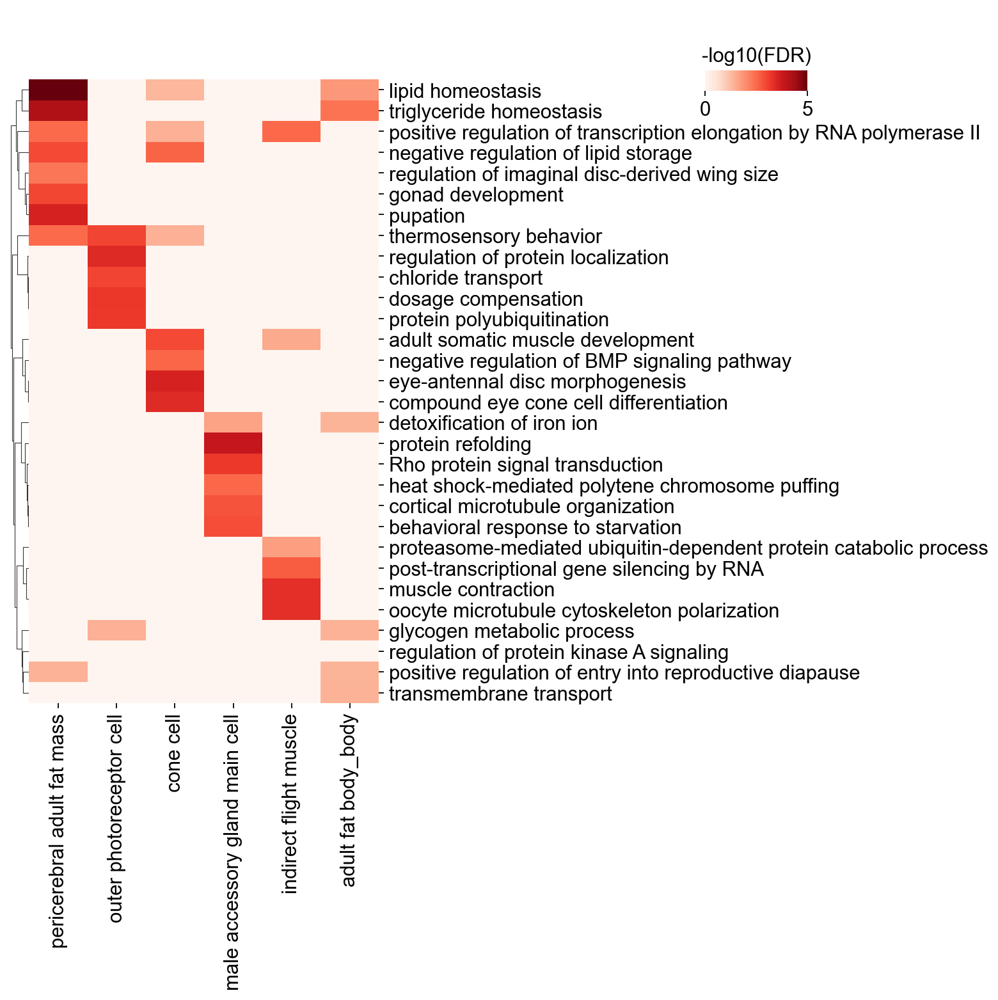

In [43]:
kws = dict(cbar_kws=dict(orientation='horizontal'))
ax=sns.clustermap(selectMtx_50d.loc[:, ['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']],
                  figsize=(10, 10), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=5,
                  col_cluster=False,) # norm=LogNorm(), , vmax=10
ax.ax_cbar.set_position((0.7, .90, .1, .02))
ax.ax_cbar.set_title('-log10(FDR)')
plt.savefig(f'{goFolder}/heatmap_goFrequency5_up_eachCelltype_top{goN}_50d_5d_vertical_selected.pdf')

In [42]:
goN=20
selectedGo_L=[]
for i, goName in enumerate(go50d_count5_Df.sort_values(by='MinusLogFdr', ascending=False).goName):
    if len(selectedGo_L) < goN:
        if goName not in selectedGo_L:
            selectedGo_L.append(goName)

In [44]:
# selected_L=[ 'adult fat body_body', 'pericerebral adult fat mass', 'adult oenocyte', 'outer photoreceptor cell', 'cone cell',  'male accessory gland main cell', 'indirect flight muscle'] #

# selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
# for cellType in selected_L:
#     if cellType in topGO_eachCelltype_D.keys():
#         for go in topGO_eachCelltype_D[cellType]:
#             if go not in selectedGo_L: selectedGo_L.append(go)
    

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L),]
selectMtx_50d=selectMtx_50d.loc[selectMtx_50d.sum(axis=1) != 0, selectMtx_50d.sum(axis=0) != 0]

# selectMtx_50d

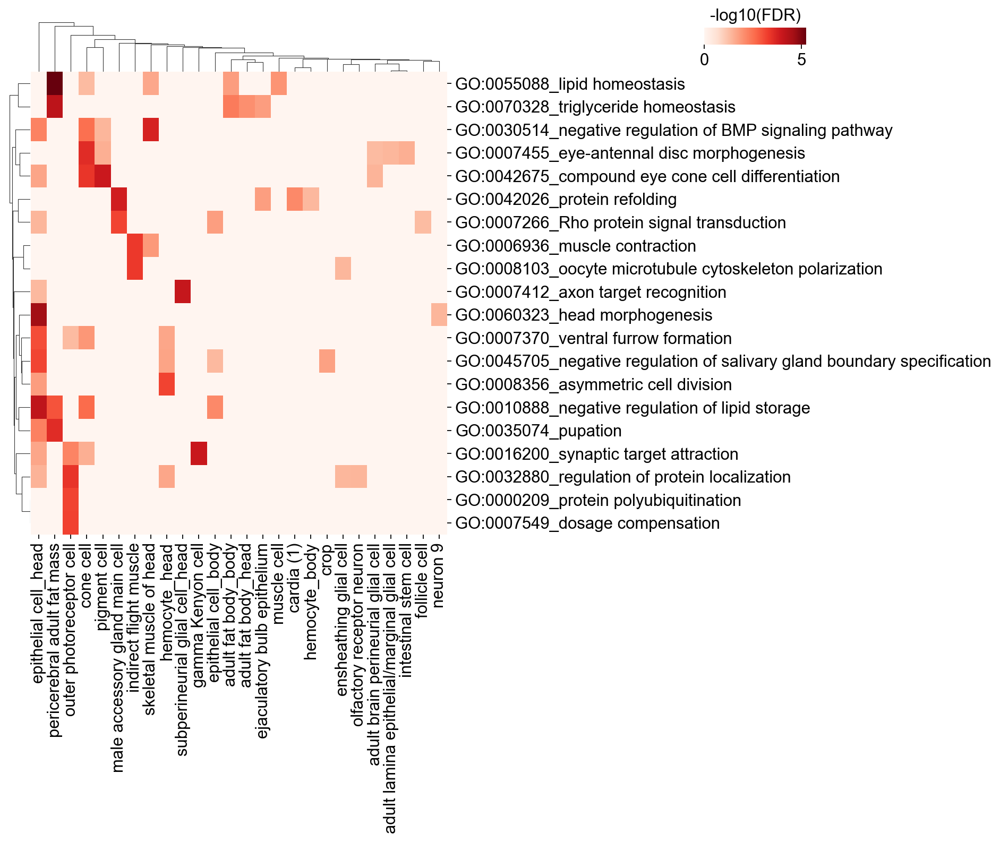

In [45]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(selectMtx_50d, figsize=(12, 10), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws) # norm=LogNorm(), , vmax=10
    ax.ax_cbar.set_position((0.7, .95, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_up_top{goN}_50d_5d_vertical_selected.pdf')

**50d/5d: over 5 GOs**

In [47]:
go50d_count5_Df=pd.read_csv(f'{goFolder}/go50d_count5_Df_up.csv')
go50d_countHigh_Df=pd.read_csv(f'{goFolder}/go50d_countHigh_Df_up.csv')
goFrequency_Df=pd.read_csv(f'{goFolder}/goFrequency_Df_up.csv')

In [48]:
go50d_countHigh_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,GO:0007411,2.268091e-11,axon guidance,Johnston organ neuron,50/5,10.644340,GO:0007411_axon guidance
1,GO:0007268,3.262751e-06,chemical synaptic transmission,Johnston organ neuron,50/5,5.486416,GO:0007268_chemical synaptic transmission
2,GO:0016319,1.918590e-05,mushroom body development,Johnston organ neuron,50/5,4.717018,GO:0016319_mushroom body development
3,GO:0098609,2.054322e-04,cell-cell adhesion,Johnston organ neuron,50/5,3.687331,GO:0098609_cell-cell adhesion
4,GO:0006357,5.419970e-04,regulation of transcription by RNA polymerase II,Johnston organ neuron,50/5,3.266003,GO:0006357_regulation of transcription by RNA ...
...,...,...,...,...,...,...,...
1821,GO:0007155,4.714610e-02,cell adhesion,transmedullary neuron Tm3a,50/5,1.326554,GO:0007155_cell adhesion
1822,GO:0007602,4.849418e-02,phototransduction,transmedullary neuron Tm3a,50/5,1.314310,GO:0007602_phototransduction
1823,GO:0040011,9.581338e-03,locomotion,transmedullary neuron Tm4,50/5,2.018574,GO:0040011_locomotion
1824,GO:0007411,3.119947e-02,axon guidance,transmedullary neuron Tm4,50/5,1.505853,GO:0007411_axon guidance


In [52]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [53]:
goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [56]:
goMtx_50d

,16-cell germline cyst in germarium region 2a and 2b,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,...,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,transmedullary neuron Tm9,visceral muscle of the crop,visceral muscle of the midgut
GO:0007411_axon guidance,0.0,10.644340,0.00000,0.000000,0.000000,0.000000,0.000000,3.522772,1.905347,0.000000,...,1.493272,0.000000,2.821408,2.738896,0.000000,2.700980,1.505853,0.0,0.0,0.000000
GO:0006357_regulation of transcription by RNA polymerase II,0.0,3.266003,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.797474,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.760045
GO:0007476_imaginal disc-derived wing morphogenesis,0.0,2.259848,0.00000,0.000000,0.000000,0.000000,0.000000,1.551549,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
GO:0006468_protein phosphorylation,0.0,3.222707,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.311723,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.904694,0.000000,0.0,0.0,0.000000
GO:0007165_signal transduction,0.0,2.401396,0.00000,1.908218,3.798180,0.000000,2.919747,0.000000,0.000000,0.000000,...,0.000000,2.052102,4.958497,0.000000,0.000000,1.803034,0.000000,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0043161_proteasome-mediated ubiquitin-dependent protein catabolic process,0.0,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
GO:0070884_regulation of calcineurin-NFAT signaling cascade,0.0,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
"GO:0007384_specification of segmental identity, thorax",0.0,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
GO:0072347_response to anesthetic,0.0,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000


In [54]:
go50d_countHigh_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,GO:0007411,2.268091e-11,axon guidance,Johnston organ neuron,50/5,10.644340,GO:0007411_axon guidance
1,GO:0007268,3.262751e-06,chemical synaptic transmission,Johnston organ neuron,50/5,5.486416,GO:0007268_chemical synaptic transmission
2,GO:0016319,1.918590e-05,mushroom body development,Johnston organ neuron,50/5,4.717018,GO:0016319_mushroom body development
3,GO:0098609,2.054322e-04,cell-cell adhesion,Johnston organ neuron,50/5,3.687331,GO:0098609_cell-cell adhesion
4,GO:0006357,5.419970e-04,regulation of transcription by RNA polymerase II,Johnston organ neuron,50/5,3.266003,GO:0006357_regulation of transcription by RNA ...
...,...,...,...,...,...,...,...
1821,GO:0007155,4.714610e-02,cell adhesion,transmedullary neuron Tm3a,50/5,1.326554,GO:0007155_cell adhesion
1822,GO:0007602,4.849418e-02,phototransduction,transmedullary neuron Tm3a,50/5,1.314310,GO:0007602_phototransduction
1823,GO:0040011,9.581338e-03,locomotion,transmedullary neuron Tm4,50/5,2.018574,GO:0040011_locomotion
1824,GO:0007411,3.119947e-02,axon guidance,transmedullary neuron Tm4,50/5,1.505853,GO:0007411_axon guidance


In [71]:
goN=20
topGO_L=[]

for go in go50d_countHigh_Df.sort_values(by='p_fdr_bh').goName:
    if len(topGO_L) < goN:
        if go not in topGO_L:
            topGO_L.append(go)
topGO_L

['GO:0007476_imaginal disc-derived wing morphogenesis',
 'GO:0007411_axon guidance',
 'GO:0006357_regulation of transcription by RNA polymerase II',
 'GO:0006468_protein phosphorylation',
 'GO:0007616_long-term memory',
 'GO:0045944_positive regulation of transcription by RNA polymerase II',
 'GO:0007268_chemical synaptic transmission',
 'GO:0007391_dorsal closure',
 'GO:0045892_negative regulation of DNA-templated transcription',
 'GO:0098609_cell-cell adhesion',
 'GO:0035556_intracellular signal transduction',
 'GO:0030036_actin cytoskeleton organization',
 'GO:0007165_signal transduction',
 'GO:0007424_open tracheal system development',
 'GO:1903688_positive regulation of border follicle cell migration',
 'GO:0007298_border follicle cell migration',
 'GO:0045880_positive regulation of smoothened signaling pathway',
 'GO:0048749_compound eye development',
 'GO:0048149_behavioral response to ethanol',
 'GO:0008340_determination of adult lifespan']

In [73]:
goN=20
# topGO_eachCelltype_L=[]
# topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(go50d_countHigh_Df.goName.value_counts().index)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


    
goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]

goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,Johnston organ neuron,T neuron T2,T neuron T2a,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,adult brain cell body glial cell,adult brain perineurial glial cell,adult differentiating enterocyte,...,subperineurial glial cell_body,subperineurial glial cell_head,transmedullary Y neuron TmY14,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm3a,transmedullary neuron Tm4,visceral muscle of the midgut
GO:0007411_axon guidance,10.644340,0.000000,0.000000,0.000000,3.522772,1.905347,0.000000,2.895763,9.277633,5.044629,...,2.816067,12.453809,0.000000,1.493272,0.000000,2.821408,2.738896,2.700980,1.505853,0.000000
GO:0006357_regulation of transcription by RNA polymerase II,3.266003,0.000000,0.000000,0.000000,0.000000,0.000000,2.797474,1.747990,11.249056,1.541889,...,1.484908,4.780943,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.760045
GO:0007476_imaginal disc-derived wing morphogenesis,2.259848,0.000000,0.000000,0.000000,1.551549,0.000000,0.000000,2.230027,12.007289,2.694938,...,1.311844,3.629974,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0006468_protein phosphorylation,3.222707,0.000000,0.000000,0.000000,0.000000,0.000000,1.311723,5.016417,9.360098,0.000000,...,0.000000,3.653657,0.000000,0.000000,0.000000,0.000000,0.000000,1.904694,0.000000,0.000000
GO:0007165_signal transduction,2.401396,1.908218,3.798180,2.919747,0.000000,0.000000,0.000000,0.000000,1.370626,0.000000,...,0.000000,0.000000,2.374354,0.000000,2.052102,4.958497,0.000000,1.803034,0.000000,0.000000
GO:0007268_chemical synaptic transmission,5.486416,0.000000,3.856339,1.846214,0.000000,0.000000,1.963594,0.000000,0.000000,0.000000,...,0.000000,1.522053,1.319768,0.000000,2.052102,3.503072,0.000000,0.000000,0.000000,0.000000
GO:0035556_intracellular signal transduction,1.792596,0.000000,0.000000,0.000000,0.000000,1.318718,0.000000,2.895763,2.337250,0.000000,...,0.000000,1.406124,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0045944_positive regulation of transcription by RNA polymerase II,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.975467,0.000000,5.841303,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007391_dorsal closure,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.634361,5.860869,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007424_open tracheal system development,2.051737,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.469291,2.762765,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


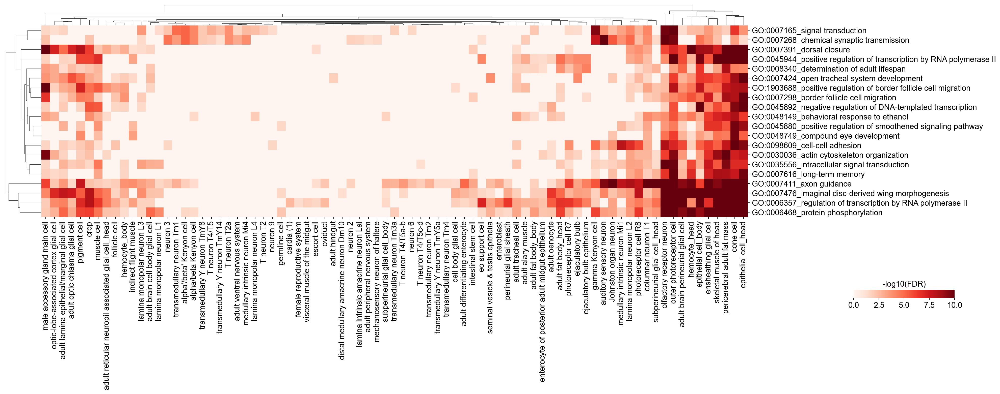

In [80]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(25, 10), xticklabels=True, yticklabels=True, cmap='Reds', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.85, .25, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_countHigh_up_eachCelltype_top{goN}_50d_5d.pdf')

### down-regulated

In [82]:
goConcatRevigo_Df=downGoConcat_Df[downGoConcat_Df['# GO'].isin(revigoNonRedundantGo_L)]
goConcatRevigo_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,GO:0002181,3.933647e-70,cytoplasmic translation,16-cell germline cyst in germarium region 2a a...,30/5,69.405205,GO:0002181_cytoplasmic translation
2,GO:0030036,8.428321e-07,actin cytoskeleton organization,16-cell germline cyst in germarium region 2a a...,30/5,6.074259,GO:0030036_actin cytoskeleton organization
3,GO:0008340,3.201202e-06,determination of adult lifespan,16-cell germline cyst in germarium region 2a a...,30/5,5.494687,GO:0008340_determination of adult lifespan
5,GO:0006468,1.871343e-05,protein phosphorylation,16-cell germline cyst in germarium region 2a a...,30/5,4.727847,GO:0006468_protein phosphorylation
7,GO:0000381,4.062554e-04,"regulation of alternative mRNA splicing, via s...",16-cell germline cyst in germarium region 2a a...,30/5,3.391201,GO:0000381_regulation of alternative mRNA spli...
...,...,...,...,...,...,...,...
16897,GO:0015986,2.351041e-02,proton motive force-driven ATP synthesis,visceral muscle of the midgut,50/5,1.628740,GO:0015986_proton motive force-driven ATP synt...
16915,GO:0002181,5.170543e-138,cytoplasmic translation,visceral muscle of the midgut,70/5,137.286464,GO:0002181_cytoplasmic translation
16917,GO:0000028,8.120071e-06,ribosomal small subunit assembly,visceral muscle of the midgut,70/5,5.090440,GO:0000028_ribosomal small subunit assembly
16920,GO:0006414,4.580440e-03,translational elongation,visceral muscle of the midgut,70/5,2.339093,GO:0006414_translational elongation


In [83]:
goConcatRevigo_Df_30d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '30/5']
goConcatRevigo_Df_50d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '50/5']
goConcatRevigo_Df_70d = goConcatRevigo_Df[goConcatRevigo_Df.ageCompare == '70/5']

### down-regulated: 50d/5d

In [46]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [47]:
topGO_L=[]

goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)

for i, goName in enumerate(goConcatRevigo_Df_50d.goName):
    if len(topGO_L) <20:
        if goName not in topGO_L: topGO_L.append(goName)

# goMtx_50d=goMtx_50d.loc[:,goMtx_50d.loc['sumGeneGo'] != 0]
# goMtx_50d.drop('sumGeneGo', axis=0, inplace=True)

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [48]:
goMtxTop_50d=goMtx_50d.loc[:,goMtx_50d.loc['sumGeneGo'] != 0]
goMtxTop_50d=goMtx_50d.loc[goMtx_50d.index.isin(topGO_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
goMtxTop_50d

,16-cell germline cyst in germarium region 2a and 2b,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,...,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,transmedullary neuron Tm9,visceral muscle of the crop,visceral muscle of the midgut
GO:0002181_cytoplasmic translation,134.531531,126.476243,98.409327,106.714865,59.200041,114.266181,30.386741,110.774944,117.652836,135.902208,...,118.815318,115.985029,103.071999,110.599929,103.757865,113.515376,117.888557,81.396346,34.280837,130.252883
GO:1902600_proton transmembrane transport,2.229310,6.983208,0.000000,2.675280,0.000000,2.689069,0.000000,4.906339,4.175248,4.089244,...,4.772016,0.000000,5.742542,7.227582,2.468157,5.306604,5.053492,0.000000,0.000000,0.000000
GO:0007268_chemical synaptic transmission,0.000000,0.000000,0.000000,6.806608,2.125090,0.000000,0.000000,9.244700,8.896364,0.000000,...,3.530059,2.566750,6.516915,8.983698,0.000000,7.475354,2.068994,1.507754,0.000000,1.628740
GO:0008340_determination of adult lifespan,0.000000,1.947381,0.000000,0.000000,1.410369,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007411_axon guidance,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0030036_actin cytoskeleton organization,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007424_open tracheal system development,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007391_dorsal closure,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0006468_protein phosphorylation,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007616_long-term memory,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [49]:
topGO_L

['GO:0002181_cytoplasmic translation',
 'GO:0019953_sexual reproduction',
 'GO:0007411_axon guidance',
 'GO:0007476_imaginal disc-derived wing morphogenesis',
 'GO:0007616_long-term memory',
 'GO:0006468_protein phosphorylation',
 'GO:0007268_chemical synaptic transmission',
 'GO:1902600_proton transmembrane transport',
 'GO:0043161_proteasome-mediated ubiquitin-dependent protein catabolic process',
 'GO:0030036_actin cytoskeleton organization',
 'GO:0048749_compound eye development',
 'GO:0007391_dorsal closure',
 'GO:0008340_determination of adult lifespan',
 'GO:0050808_synapse organization',
 'GO:0007298_border follicle cell migration',
 'GO:0007165_signal transduction',
 'GO:0007424_open tracheal system development',
 'GO:0006357_regulation of transcription by RNA polymerase II',
 'GO:0016319_mushroom body development',
 'GO:0035556_intracellular signal transduction']

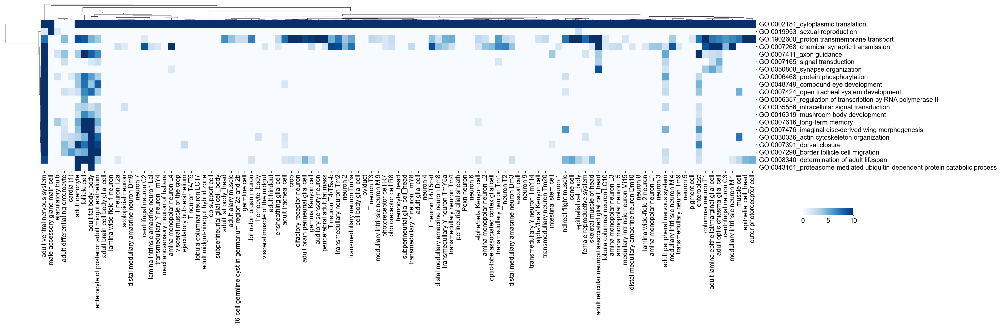

In [72]:
with rc_context({'figure.figsize': (40, 30)}):
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d,  figsize=(30, 10), xticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10)
    ax.ax_cbar.set_position((0.80, .35, .05, .02))
    plt.savefig(f'{goFolder}/heatmap_GO_down_top20_50d_5d.pdf')

**50d/5d: Use top 10 GOs from each cell type**

In [84]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [85]:
goN=5
topGO_eachCelltype_L=[]
topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d.iloc[:,:]
# goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


for cellType in goMtxTop_50d.columns:
    # print(cellType)
    
    cellType_mtx=pd.DataFrame(goMtxTop_50d.loc[:,cellType])
    cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
    cellTypeTopGo_L=cellType_mtx.index.to_list()[:goN]
    # print(cellTypeTopGo_L)
    if len(cellTypeTopGo_L) != 0:
        for i, go in enumerate(cellTypeTopGo_L):
            if goMtxTop_50d.loc[go, cellType] != 0:
                if cellType in topGO_eachCelltype_D.keys(): topGO_eachCelltype_D[cellType].append(go)
                if cellType not in topGO_eachCelltype_D.keys():
                    topGO_eachCelltype_D[cellType] = [go]

                if go not in topGO_eachCelltype_L: 
                    topGO_eachCelltype_L.append(go)
                    


goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_eachCelltype_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
goMtxTop_50d

,16-cell germline cyst in germarium region 2a and 2b,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,...,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,transmedullary neuron Tm9,visceral muscle of the crop,visceral muscle of the midgut
GO:0002181_cytoplasmic translation,134.531531,126.476243,98.409327,106.714865,59.200041,114.266181,30.386741,110.774944,117.652836,135.902208,...,118.815318,115.985029,103.071999,110.599929,103.757865,113.515376,117.888557,81.396346,34.280837,130.252883
GO:0000028_ribosomal small subunit assembly,1.93105,5.823091,4.197596,2.780267,1.765012,2.689069,0,3.684361,3.905979,7.938944,...,2.924353,3.199851,2.433752,3.577361,3.544443,2.491634,3.028955,0,0,6.662872
GO:1902600_proton transmembrane transport,2.22931,6.983208,0,2.67528,0,2.689069,0,4.906339,4.175248,4.089244,...,4.772016,0,5.742542,7.227582,2.468157,5.306604,5.053492,0,0,0
GO:0015986_proton motive force-driven ATP synthesis,1.740976,6.800874,0,1.4475,0,1.51305,0,3.274154,2.202746,5.629302,...,3.834164,0,4.431075,9.035675,0,3.393007,4.013371,0,0,1.62874
GO:0007268_chemical synaptic transmission,0,0,0,6.806608,2.12509,0,0,9.2447,8.896364,0,...,3.530059,2.56675,6.516915,8.983698,0,7.475354,2.068994,1.507754,0,1.62874
GO:0006414_translational elongation,2.22931,0,1.356811,0,0,0,0,0,0,2.149068,...,0,0,1.674811,1.495973,0,0,0,0,0,2.168945
GO:0042026_protein refolding,0,3.807241,0,1.77055,1.815891,2.689069,0,0,0,0,...,0,0,3.001006,0,0,1.364315,0,0,0,0
GO:0008340_determination of adult lifespan,0,1.947381,0,0,1.410369,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
GO:0046716_muscle cell cellular homeostasis,0,1.659835,0,0,0,0,0,0,0,1.995003,...,0,0,0,2.164909,0,2.399538,1.8693,0,0,0
"GO:0000381_regulation of alternative mRNA splicing, via spliceosome",0,0,0,0,0,2.206547,0,0,0,0,...,0,0,5.154385,0,0,2.359779,0,0,0,0


In [86]:
goMtx_50d.index = [x.split('_')[-1] for x in goMtx_50d.index]
goMtxTop_50d.index = [x.split('_')[-1] for x in goMtxTop_50d.index]

In [87]:
selectCellType_L=['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']
goMtxTop_50d_s = goMtxTop_50d.loc[:, selectCellType_L]

goMtxTop_50d_s

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
cytoplasmic translation,120.074886,89.590958,100.005818,90.068444,101.673678,40.172803
ribosomal small subunit assembly,4.982695,3.948798,3.656016,2.868363,6.198882,1.95521
proton transmembrane transport,11.997273,10.396319,13.18066,0,7.381816,4.77074
proton motive force-driven ATP synthesis,12.349221,9.476446,9.874986,3.432983,11.268926,3.094849
chemical synaptic transmission,1.703253,0,0,0,0,0
translational elongation,4.155943,2.425224,3.039971,2.292391,1.900234,2.060766
protein refolding,0,4.379446,2.782557,0,0,2.822291
determination of adult lifespan,3.924084,4.928878,5.253933,0,4.54544,12.585679
muscle cell cellular homeostasis,2.118056,0,1.305003,0,0,2.507716
"regulation of alternative mRNA splicing, via spliceosome",0,4.476824,0,0,0,5.078448


In [88]:
selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
for cellType in selectCellType_L:
    if cellType in topGO_eachCelltype_D.keys():
        for go in topGO_eachCelltype_D[cellType]:
            go=go.split('_')[-1]
            if go not in selectedGo_L: 
                selectedGo_L.append(go)
    

selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L), selectCellType_L] # 

# selectCellType_L
# selectMtx_50d=goMtxTop_50d_s.loc[selectedGo_L, :]

# selectMtx_50d=selectMtx_50d.loc[:, selectMtx_50d.sum(axis=0) != 0]

selectMtx_50d

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
cytoplasmic translation,120.074886,89.590958,100.005818,90.068444,101.673678,40.172803
ribosomal small subunit assembly,4.982695,3.948798,3.656016,2.868363,6.198882,1.95521
proton transmembrane transport,11.997273,10.396319,13.18066,0,7.381816,4.77074
proton motive force-driven ATP synthesis,12.349221,9.476446,9.874986,3.432983,11.268926,3.094849
translational elongation,4.155943,2.425224,3.039971,2.292391,1.900234,2.060766
determination of adult lifespan,3.924084,4.928878,5.253933,0,4.54544,12.585679
glucose homeostasis,4.386109,0,2.123365,0,4.54544,2.794094
phototransduction,2.05088,6.983459,12.784169,0,0,0
actin cytoskeleton organization,0,0,0,0,0,11.067013
mitochondrial respiratory chain complex I assembly,0,5.665234,5.221779,0,0,3.688839


In [89]:
selectMtx_50d=selectMtx_50d.astype(float)

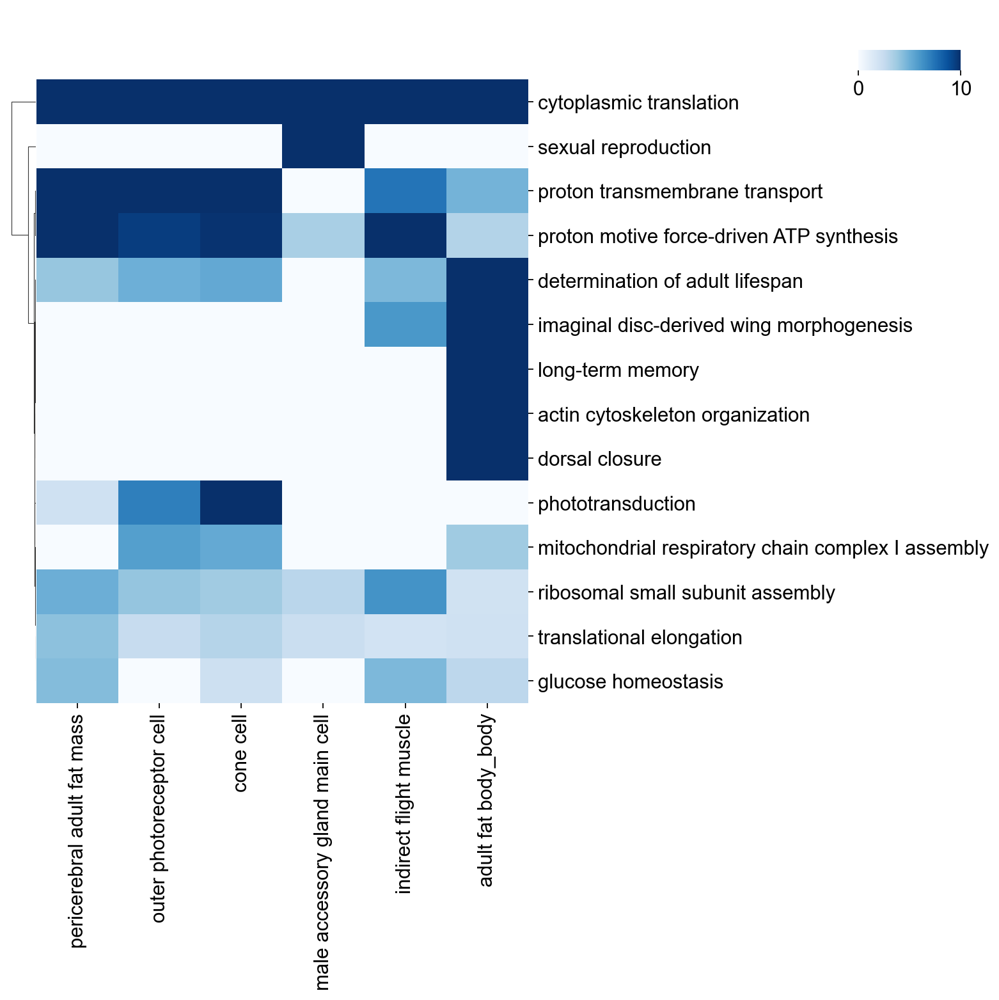

In [90]:
kws = dict(cbar_kws=dict(orientation='horizontal'))
ax=sns.clustermap(selectMtx_50d, figsize=(10,10), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10, col_cluster=False)
ax.ax_cbar.set_position((0.85, .92, .1, .02))
# plt.savefig(f'{goFolder}/heatmap_GO_up_eachCelltype_top{goN}_30d_5d.pdf')

### Check distribution of GO frequency

In [51]:
goFrequency_Df = pd.DataFrame(goConcatRevigo_Df_50d.goName.value_counts())
goFrequency_Df.columns = ['counts']
goFrequency_Df.insert(0, 'goName', goFrequency_Df.index.to_list())
goFrequency_Df

,goName,counts
GO:0002181_cytoplasmic translation,GO:0002181_cytoplasmic translation,104
GO:0000028_ribosomal small subunit assembly,GO:0000028_ribosomal small subunit assembly,84
GO:1902600_proton transmembrane transport,GO:1902600_proton transmembrane transport,58
GO:0015986_proton motive force-driven ATP synthesis,GO:0015986_proton motive force-driven ATP synt...,52
GO:0007268_chemical synaptic transmission,GO:0007268_chemical synaptic transmission,46
...,...,...
GO:0061864_basement membrane constituent secretion,GO:0061864_basement membrane constituent secre...,1
GO:0006641_triglyceride metabolic process,GO:0006641_triglyceride metabolic process,1
GO:0071588_hydrogen peroxide mediated signaling pathway,GO:0071588_hydrogen peroxide mediated signalin...,1
GO:0007059_chromosome segregation,GO:0007059_chromosome segregation,1


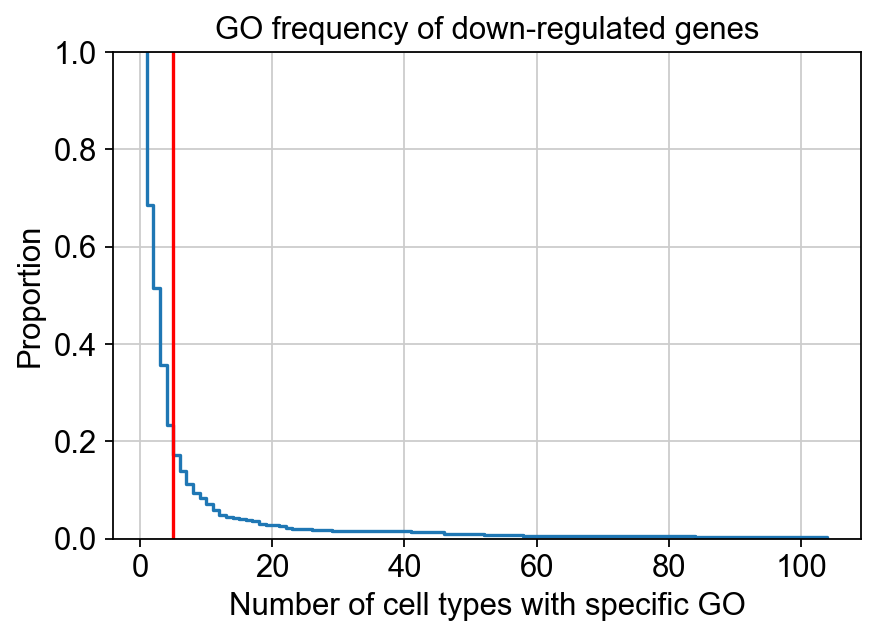

In [52]:
with rc_context({'figure.figsize': (6, 4)}):
    sns.ecdfplot(data=goFrequency_Df, x="counts", complementary=True)
    plt.xlabel('Number of cell types with specific GO')
    plt.axvline(5, color='red')
    plt.title('GO frequency of down-regulated genes')
    plt.savefig(f'{goFolder}/goFrequency_down.pdf')

In [53]:
goFrequency_Df[goFrequency_Df['counts'] > 5]

,goName,counts
GO:0002181_cytoplasmic translation,GO:0002181_cytoplasmic translation,104
GO:0000028_ribosomal small subunit assembly,GO:0000028_ribosomal small subunit assembly,84
GO:1902600_proton transmembrane transport,GO:1902600_proton transmembrane transport,58
GO:0015986_proton motive force-driven ATP synthesis,GO:0015986_proton motive force-driven ATP synt...,52
GO:0007268_chemical synaptic transmission,GO:0007268_chemical synaptic transmission,46
...,...,...
GO:0045807_positive regulation of endocytosis,GO:0045807_positive regulation of endocytosis,6
GO:0016192_vesicle-mediated transport,GO:0016192_vesicle-mediated transport,6
GO:0006508_proteolysis,GO:0006508_proteolysis,6
GO:0007291_sperm individualization,GO:0007291_sperm individualization,6


In [54]:
goFrequency5_L=goFrequency_Df[goFrequency_Df['counts'] <= 5].goName.to_list()
goFrequencyHigh_L=goFrequency_Df[goFrequency_Df['counts'] > 5].goName.to_list()
goFrequency_D = dict(zip(goFrequency_Df.index.to_list(), goFrequency_Df.counts.to_list()))

In [55]:
go50d_count5_Df = goConcatRevigo_Df_50d[goConcatRevigo_Df_50d.goName.isin(goFrequency5_L)]
go50d_countHigh_Df = goConcatRevigo_Df_50d[~goConcatRevigo_Df_50d.goName.isin(goFrequency5_L)]
go50d_count5_Df

,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
12790,GO:0019953,3.768435e-74,sexual reproduction,male accessory gland main cell,50/5,73.423839,GO:0019953_sexual reproduction
3278,GO:0043161,2.878412e-19,proteasome-mediated ubiquitin-dependent protei...,adult oenocyte,50/5,18.540847,GO:0043161_proteasome-mediated ubiquitin-depen...
5263,GO:0006357,7.975344e-14,regulation of transcription by RNA polymerase II,adult ventral nervous system,50/5,13.098251,GO:0006357_regulation of transcription by RNA ...
1802,GO:0043161,1.629092e-10,proteasome-mediated ubiquitin-dependent protei...,adult fat body_body,50/5,9.788054,GO:0043161_proteasome-mediated ubiquitin-depen...
5280,GO:0045944,6.321414e-09,positive regulation of transcription by RNA po...,adult ventral nervous system,50/5,8.199186,GO:0045944_positive regulation of transcriptio...
...,...,...,...,...,...,...,...
2895,GO:0051643,4.946498e-02,endoplasmic reticulum localization,adult lamina epithelial/marginal glial cell,50/5,1.305702,GO:0051643_endoplasmic reticulum localization
2892,GO:0009410,4.946498e-02,response to xenobiotic stimulus,adult lamina epithelial/marginal glial cell,50/5,1.305702,GO:0009410_response to xenobiotic stimulus
2890,GO:0008088,4.946498e-02,axo-dendritic transport,adult lamina epithelial/marginal glial cell,50/5,1.305702,GO:0008088_axo-dendritic transport
4442,GO:0030431,4.951558e-02,sleep,adult reticular neuropil associated glial cell...,50/5,1.305258,GO:0030431_sleep


In [56]:
go50d_count5_Df.to_csv(f'{goFolder}/go50d_count5_Df_down.csv', index=False)
go50d_countHigh_Df.to_csv(f'{goFolder}/go50d_countHigh_Df_down.csv')
goFrequency_Df.to_csv(f'{goFolder}/goFrequency_Df_down.csv', index=False)

**50d/5d: within 5 GOs**

In [57]:
go50d_count5_Df=pd.read_csv(f'{goFolder}/go50d_count5_Df_down.csv')
go50d_countHigh_Df=pd.read_csv(f'{goFolder}/go50d_countHigh_Df_down.csv')
goFrequency_Df=pd.read_csv(f'{goFolder}/goFrequency_Df_down.csv')

In [58]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [59]:
goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [60]:
goMtx_50d

,16-cell germline cyst in germarium region 2a and 2b,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,...,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,transmedullary neuron Tm9,visceral muscle of the crop,visceral muscle of the midgut
GO:0002181_cytoplasmic translation,134.531531,126.476243,98.409327,106.714865,59.200041,114.266181,30.386741,110.774944,117.652836,135.902208,...,118.815318,115.985029,103.071999,110.599929,103.757865,113.515376,117.888557,81.396346,34.280837,130.252883
GO:0000028_ribosomal small subunit assembly,1.931050,5.823091,4.197596,2.780267,1.765012,2.689069,0.000000,3.684361,3.905979,7.938944,...,2.924353,3.199851,2.433752,3.577361,3.544443,2.491634,3.028955,0.000000,0.000000,6.662872
GO:1902600_proton transmembrane transport,2.229310,6.983208,0.000000,2.675280,0.000000,2.689069,0.000000,4.906339,4.175248,4.089244,...,4.772016,0.000000,5.742542,7.227582,2.468157,5.306604,5.053492,0.000000,0.000000,0.000000
GO:0015986_proton motive force-driven ATP synthesis,1.740976,6.800874,0.000000,1.447500,0.000000,1.513050,0.000000,3.274154,2.202746,5.629302,...,3.834164,0.000000,4.431075,9.035675,0.000000,3.393007,4.013371,0.000000,0.000000,1.628740
GO:0007268_chemical synaptic transmission,0.000000,0.000000,0.000000,6.806608,2.125090,0.000000,0.000000,9.244700,8.896364,0.000000,...,3.530059,2.566750,6.516915,8.983698,0.000000,7.475354,2.068994,1.507754,0.000000,1.628740
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0006641_triglyceride metabolic process,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0071588_hydrogen peroxide mediated signaling pathway,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007059_chromosome segregation,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0042953_lipoprotein transport,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [61]:
goN=5
topGO_eachCelltype_L=[]
topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


for cellType in goMtxTop_50d.columns:
    # print(cellType)
    
    cellType_mtx=pd.DataFrame(goMtxTop_50d.loc[:,cellType])
    cellType_mtx.sort_values(by=cellType, ascending=False, inplace=True)
    cellTypeTopGo_L=cellType_mtx.index.to_list()[:goN]
    # print(cellTypeTopGo_L)
    if len(cellTypeTopGo_L) != 0:
        for i, go in enumerate(cellTypeTopGo_L):
            if goMtxTop_50d.loc[go, cellType] != 0:
                if cellType in topGO_eachCelltype_D.keys(): topGO_eachCelltype_D[cellType].append(go)
                if cellType not in topGO_eachCelltype_D.keys():
                    topGO_eachCelltype_D[cellType] = [go]

                if go not in topGO_eachCelltype_L: 
                    topGO_eachCelltype_L.append(go)
                    


goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_eachCelltype_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]
goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,T neuron T2a,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,adult differentiating enterocyte,adult fat body_body,adult hindgut,adult lamina epithelial/marginal glial cell,adult oenocyte,adult optic chiasma glial cell,...,muscle cell,neuron 2,olfactory receptor neuron,outer photoreceptor cell,oviduct,pericerebral adult fat mass,photoreceptor cell R7,photoreceptor cell R8,skeletal muscle of head,transmedullary neuron Tm1
GO:0045786_negative regulation of cell cycle,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,2.06744,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0040011_locomotion,0.0,0.0,0.0,2.868847,0.000000,0.000000,0.000000,0.0,1.540046,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0001933_negative regulation of protein phosphorylation,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,2.271063,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0036335_intestinal stem cell homeostasis,0.0,0.0,0.0,0.000000,0.000000,3.674406,0.000000,0.0,1.666423,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0007266_Rho protein signal transduction,0.0,0.0,0.0,0.000000,3.171355,3.094849,0.000000,0.0,1.390130,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GO:0051646_mitochondrion localization,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0007300_ovarian nurse cell to oocyte transport,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
GO:0002121_inter-male aggressive behavior,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.627777
GO:0045010_actin nucleation,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.793524,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000


In [62]:
goMtx_50d.index = [x.split('_')[-1] for x in goMtx_50d.index]
goMtxTop_50d.index = [x.split('_')[-1] for x in goMtxTop_50d.index]

goMtxTop_50d

,T neuron T2a,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,adult differentiating enterocyte,adult fat body_body,adult hindgut,adult lamina epithelial/marginal glial cell,adult oenocyte,adult optic chiasma glial cell,...,muscle cell,neuron 2,olfactory receptor neuron,outer photoreceptor cell,oviduct,pericerebral adult fat mass,photoreceptor cell R7,photoreceptor cell R8,skeletal muscle of head,transmedullary neuron Tm1
negative regulation of cell cycle,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,2.06744,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
locomotion,0.0,0.0,0.0,2.868847,0.000000,0.000000,0.000000,0.0,1.540046,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
negative regulation of protein phosphorylation,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,2.271063,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
intestinal stem cell homeostasis,0.0,0.0,0.0,0.000000,0.000000,3.674406,0.000000,0.0,1.666423,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
Rho protein signal transduction,0.0,0.0,0.0,0.000000,3.171355,3.094849,0.000000,0.0,1.390130,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mitochondrion localization,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
ovarian nurse cell to oocyte transport,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
inter-male aggressive behavior,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.627777
actin nucleation,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.793524,0.0,0.000000,0.0,...,0.0,0.00000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000


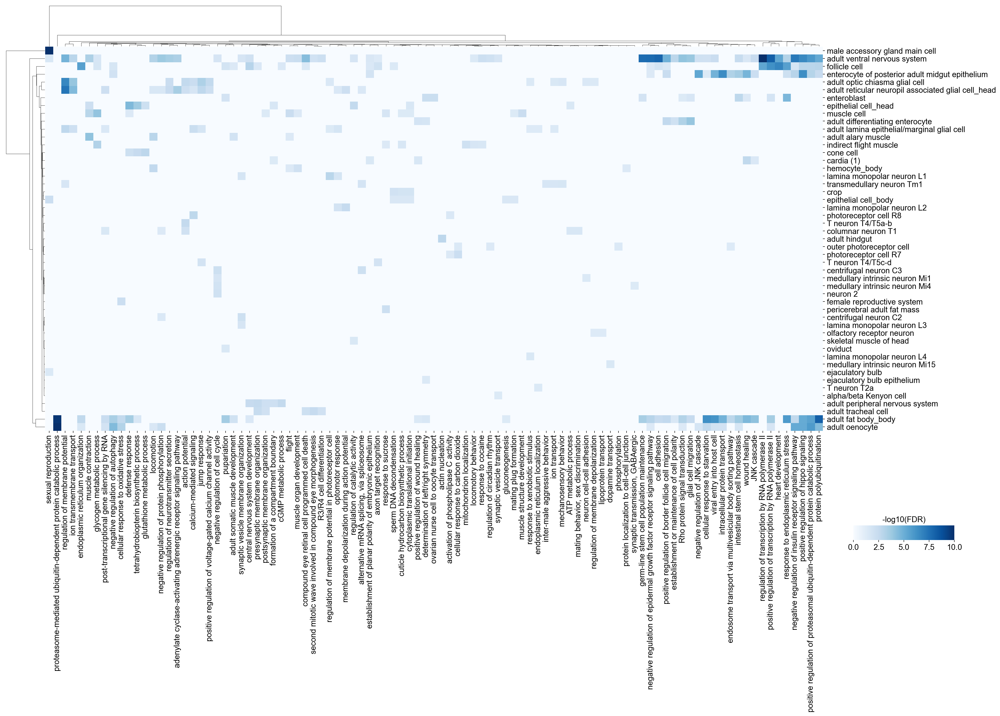

In [127]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d.transpose(), figsize=(25, 18), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.85, .25, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_down_eachCelltype_top{goN}_50d_5d.pdf')

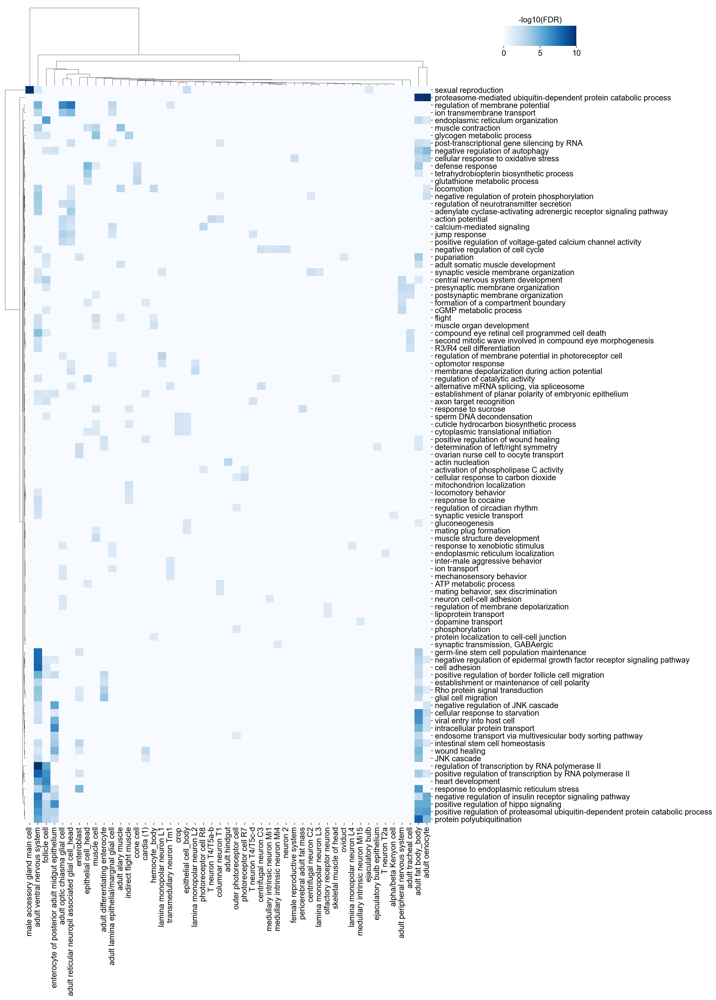

In [128]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(18, 25), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.7, .95, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_down_eachCelltype_top{goN}_50d_5d_vertical.pdf')

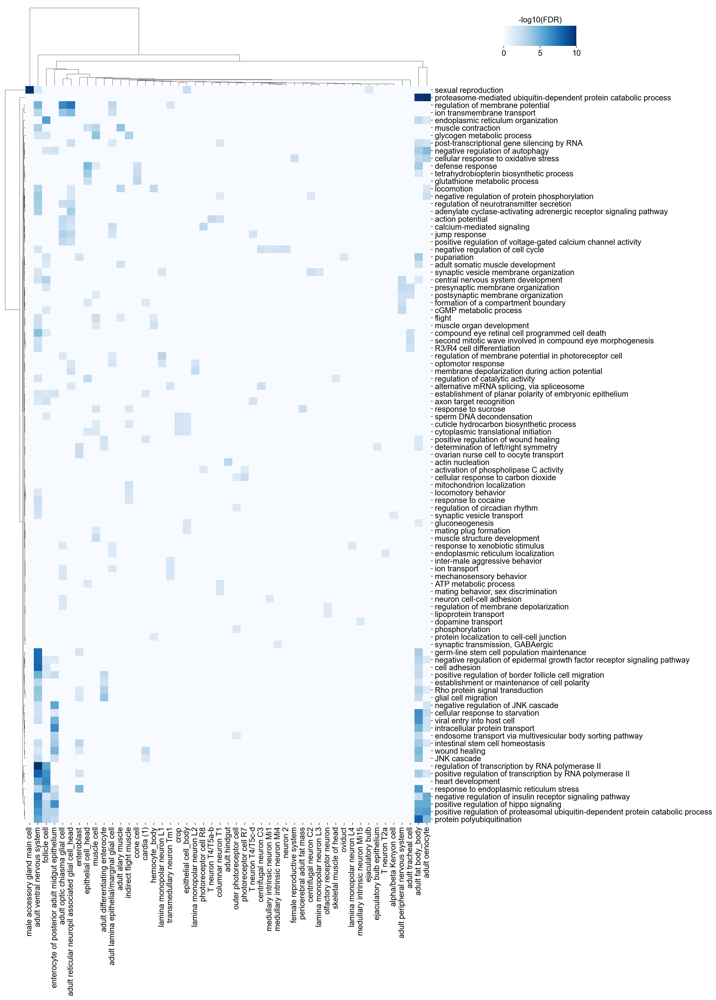

In [129]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(18, 25), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.7, .95, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_down_eachCelltype_top{goN}_50d_5d_vertical.pdf')

In [71]:
pd.DataFrame(goMtx_50d.loc['cytoplasmic translation', ['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']]).transpose()

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
cytoplasmic translation,120.074886,89.590958,100.005818,90.068444,101.673678,40.172803


In [66]:
go50d_countHigh_Df

,Unnamed: 0,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,3005,GO:0002181,1.195331e-165,cytoplasmic translation,adult midgut-hindgut hybrid zone,50/5,164.922512,GO:0002181_cytoplasmic translation
1,15849,GO:0002181,5.970641e-149,cytoplasmic translation,subperineurial glial cell_body,50/5,148.223979,GO:0002181_cytoplasmic translation
2,9192,GO:0002181,3.861269e-148,cytoplasmic translation,eo support cell,50/5,147.413270,GO:0002181_cytoplasmic translation
3,892,GO:0002181,1.252540e-136,cytoplasmic translation,adult alary muscle,50/5,135.902208,GO:0002181_cytoplasmic translation
4,98,GO:0002181,2.940826e-135,cytoplasmic translation,16-cell germline cyst in germarium region 2a a...,50/5,134.531531,GO:0002181_cytoplasmic translation
...,...,...,...,...,...,...,...,...
1032,15961,GO:0046716,4.951929e-02,muscle cell cellular homeostasis,transmedullary Y neuron TmY14,50/5,1.305226,GO:0046716_muscle cell cellular homeostasis
1033,7390,GO:0046716,4.954471e-02,muscle cell cellular homeostasis,cone cell,50/5,1.305003,GO:0046716_muscle cell cellular homeostasis
1034,12737,GO:0007605,4.958776e-02,sensory perception of sound,lobula columnar neuron LC17,50/5,1.304626,GO:0007605_sensory perception of sound
1035,13213,GO:0007605,4.980787e-02,sensory perception of sound,medullary intrinsic neuron Mi4,50/5,1.302702,GO:0007605_sensory perception of sound


In [72]:
selected_L=['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body'] #

selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
for cellType in selected_L:
    if cellType in topGO_eachCelltype_D.keys():
        for go in topGO_eachCelltype_D[cellType]:
            go=go.split('_')[-1]
            if go not in selectedGo_L: selectedGo_L.append(go)
    

# selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L), goMtxTop_50d.columns.isin(selected_L)] 
selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L), selected_L] 

selectMtx_50d=selectMtx_50d.loc[:, selectMtx_50d.sum(axis=0) != 0]

selectMtx_50d

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
protein polyubiquitination,0.000000,0.000000,0.000000,0.000000,0.000000,8.155230
response to endoplasmic reticulum stress,0.000000,0.000000,0.000000,0.000000,0.000000,5.878613
sexual reproduction,0.000000,0.000000,0.000000,73.423839,0.000000,0.000000
cuticle hydrocarbon biosynthetic process,0.000000,0.000000,0.000000,0.000000,1.585829,0.000000
glycogen metabolic process,0.000000,0.000000,0.000000,0.000000,3.129774,0.000000
cellular response to starvation,0.000000,0.000000,0.000000,0.000000,0.000000,6.338150
viral entry into host cell,0.000000,0.000000,0.000000,0.000000,0.000000,6.152800
defense response,0.000000,0.000000,2.126103,0.000000,0.000000,3.529426
tetrahydrobiopterin biosynthetic process,0.000000,0.000000,2.481247,0.000000,0.000000,1.579094
response to sucrose,2.219928,0.000000,0.000000,0.000000,1.395756,0.000000


In [74]:
selectMtx_50d=\
    pd.concat([
    pd.DataFrame(goMtx_50d.loc['cytoplasmic translation', ['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']]).transpose(), 
    selectMtx_50d])

In [ ]:
selectMtx_50d

,pericerebral adult fat mass,outer photoreceptor cell,cone cell,male accessory gland main cell,indirect flight muscle,adult fat body_body
cytoplasmic translation,120.074886,89.590958,100.005818,90.068444,101.673678,40.172803
protein polyubiquitination,0.000000,0.000000,0.000000,0.000000,0.000000,8.155230
response to endoplasmic reticulum stress,0.000000,0.000000,0.000000,0.000000,0.000000,5.878613
sexual reproduction,0.000000,0.000000,0.000000,73.423839,0.000000,0.000000
cuticle hydrocarbon biosynthetic process,0.000000,0.000000,0.000000,0.000000,1.585829,0.000000
glycogen metabolic process,0.000000,0.000000,0.000000,0.000000,3.129774,0.000000
cellular response to starvation,0.000000,0.000000,0.000000,0.000000,0.000000,6.338150
viral entry into host cell,0.000000,0.000000,0.000000,0.000000,0.000000,6.152800
defense response,0.000000,0.000000,2.126103,0.000000,0.000000,3.529426
tetrahydrobiopterin biosynthetic process,0.000000,0.000000,2.481247,0.000000,0.000000,1.579094


/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_98379/4114730506.py:9: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


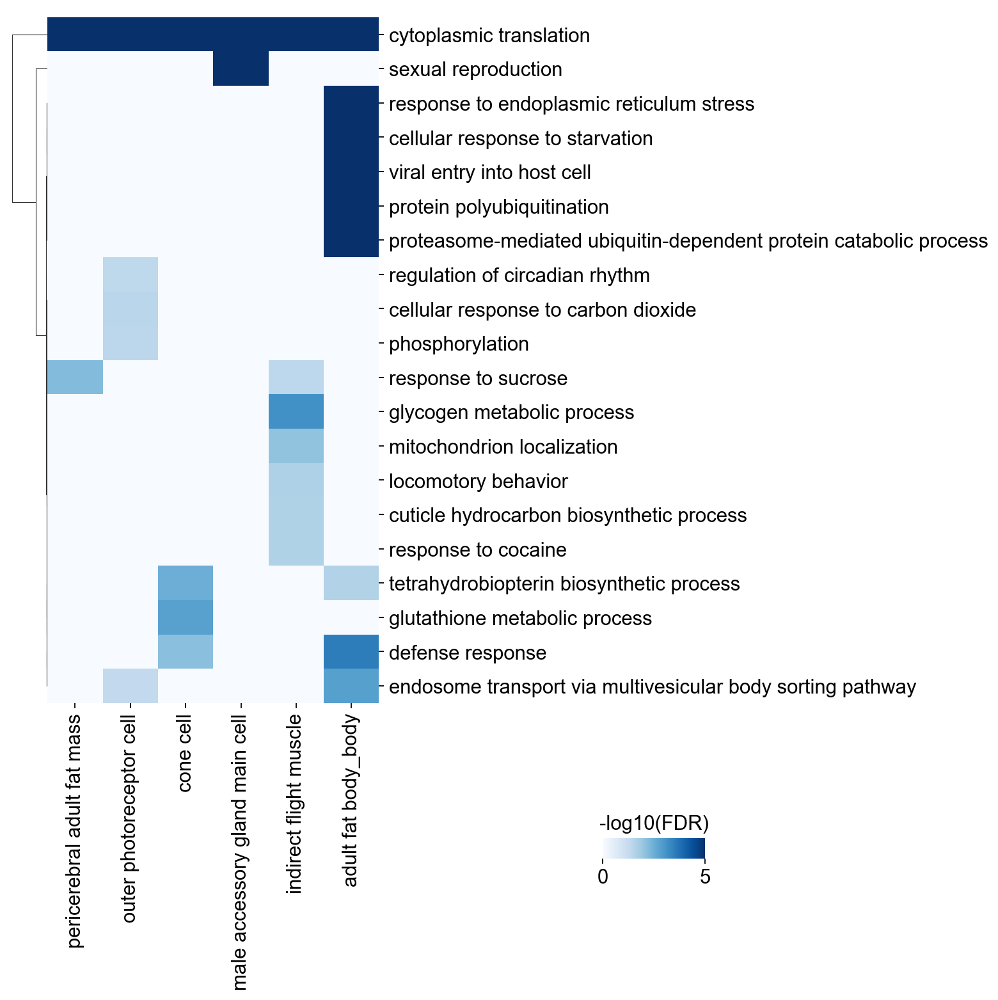

In [76]:
# kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
kws = dict(cbar_kws=dict(orientation='horizontal'))
ax=sns.clustermap(selectMtx_50d,
    # selectMtx_50d.loc[:, ['pericerebral adult fat mass', 'outer photoreceptor cell', 'cone cell', 'male accessory gland main cell', 'indirect flight muscle', 'adult fat body_body']],
                  figsize=(10, 10), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.1, 0.01),  **kws, vmax=5,
                  col_cluster=False,) # norm=LogNorm(), , vmax=10
ax.ax_cbar.set_position((0.6, .15, .1, .02))
ax.ax_cbar.set_title('-log10(FDR)')
plt.tight_layout()
plt.savefig(f'{goFolder}/heatmap_goFrequency5_down_eachCelltype_top{goN}_50d_5d_vertical_selected.pdf')

In [107]:
goN=20
selectedGo_L=[]
for i, goName in enumerate(go50d_count5_Df.sort_values(by='MinusLogFdr', ascending=False).goName):
    if len(selectedGo_L) < goN:
        if goName not in selectedGo_L:
            selectedGo_L.append(goName)

In [108]:
# selected_L=[ 'adult fat body_body', 'pericerebral adult fat mass', 'adult oenocyte', 'outer photoreceptor cell', 'cone cell',  'male accessory gland main cell', 'indirect flight muscle'] #

# selectedGo_L=[] # go50d_count5_Df[go50d_count5_Df.annotation.isin(selected_L)].goName.to_list()
# for cellType in selected_L:
#     if cellType in topGO_eachCelltype_D.keys():
#         for go in topGO_eachCelltype_D[cellType]:
#             if go not in selectedGo_L: selectedGo_L.append(go)
    

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(goFrequency5_L)]
selectMtx_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(selectedGo_L),]
selectMtx_50d=selectMtx_50d.loc[selectMtx_50d.sum(axis=1) != 0, selectMtx_50d.sum(axis=0) != 0]

selectMtx_50d

,adult fat body_body,adult lamina epithelial/marginal glial cell,adult oenocyte,adult optic chiasma glial cell,adult reticular neuropil associated glial cell_head,adult ventral nervous system,ejaculatory bulb,enteroblast,enterocyte of posterior adult midgut epithelium,epithelial cell_body,follicle cell,male accessory gland main cell,transmedullary neuron Tm1
GO:0045944_positive regulation of transcription by RNA polymerase II,3.516311,0.000000,1.710867,0.000000,0.000000,8.199186,0.000000,1.780069,0.000000,0.000000,6.288541,0.000000,0.000000
GO:0030431_sleep,2.135572,0.000000,0.000000,1.706290,1.305258,7.314356,0.000000,0.000000,0.000000,0.000000,1.758249,0.000000,0.000000
GO:0032436_positive regulation of proteasomal ubiquitin-dependent protein catabolic process,5.518114,0.000000,5.845681,0.000000,0.000000,5.966330,0.000000,0.000000,3.022751,0.000000,2.862196,0.000000,0.000000
GO:0042391_regulation of membrane potential,0.000000,2.697491,0.000000,6.602692,7.336629,4.800702,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.627777
GO:0042059_negative regulation of epidermal growth factor receptor signaling pathway,3.007112,0.000000,1.390130,0.000000,0.000000,7.724079,0.000000,0.000000,1.392801,0.000000,1.383873,0.000000,0.000000
GO:0034976_response to endoplasmic reticulum stress,5.878613,0.000000,0.000000,0.000000,0.000000,3.094381,0.000000,4.585193,2.136153,0.000000,5.590688,0.000000,0.000000
GO:0046627_negative regulation of insulin receptor signaling pathway,2.689828,0.000000,5.190039,0.000000,0.000000,7.194732,0.000000,0.000000,3.003603,0.000000,1.734972,0.000000,0.000000
GO:0035332_positive regulation of hippo signaling,5.145090,0.000000,5.190039,0.000000,0.000000,6.569822,0.000000,0.000000,6.405074,0.000000,2.873503,0.000000,0.000000
GO:0000209_protein polyubiquitination,8.155230,0.000000,4.419700,0.000000,0.000000,5.220852,0.000000,0.000000,2.488365,0.000000,2.941959,0.000000,0.000000
GO:0019953_sexual reproduction,0.000000,0.000000,0.000000,0.000000,0.000000,1.584579,1.438052,0.000000,0.000000,2.242054,0.000000,73.423839,0.000000


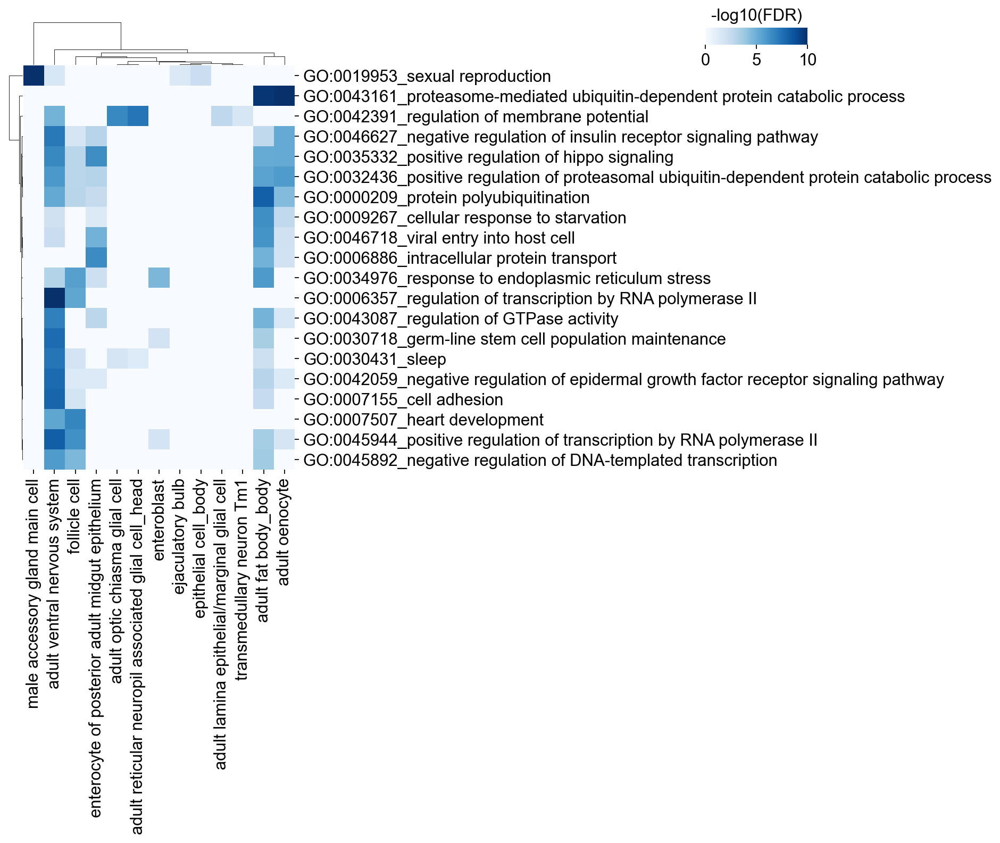

In [109]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(selectMtx_50d, figsize=(12, 10), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), , vmax=10
    ax.ax_cbar.set_position((0.7, .95, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_goFrequency5_down_top{goN}_50d_5d_vertical_selected.pdf')

**50d/5d: over 5 GOs**

In [87]:
go50d_count5_Df=pd.read_csv(f'{goFolder}/go50d_count5_Df_down.csv')
go50d_countHigh_Df=pd.read_csv(f'{goFolder}/go50d_countHigh_Df_down.csv')
goFrequency_Df=pd.read_csv(f'{goFolder}/goFrequency_Df_down.csv')

In [88]:
go50d_countHigh_Df

,Unnamed: 0,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,98,GO:0002181,2.940826e-135,cytoplasmic translation,16-cell germline cyst in germarium region 2a a...,50/5,134.531531,GO:0002181_cytoplasmic translation
1,102,GO:0006414,5.897797e-03,translational elongation,16-cell germline cyst in germarium region 2a a...,50/5,2.229310,GO:0006414_translational elongation
2,103,GO:1902600,5.897797e-03,proton transmembrane transport,16-cell germline cyst in germarium region 2a a...,50/5,2.229310,GO:1902600_proton transmembrane transport
3,104,GO:0000028,1.172059e-02,ribosomal small subunit assembly,16-cell germline cyst in germarium region 2a a...,50/5,1.931050,GO:0000028_ribosomal small subunit assembly
4,105,GO:0042273,1.308987e-02,ribosomal large subunit biogenesis,16-cell germline cyst in germarium region 2a a...,50/5,1.883065,GO:0042273_ribosomal large subunit biogenesis
...,...,...,...,...,...,...,...,...
1032,16890,GO:0002181,5.586202e-131,cytoplasmic translation,visceral muscle of the midgut,50/5,130.252883,GO:0002181_cytoplasmic translation
1033,16892,GO:0000028,2.173340e-07,ribosomal small subunit assembly,visceral muscle of the midgut,50/5,6.662872,GO:0000028_ribosomal small subunit assembly
1034,16895,GO:0006414,6.777273e-03,translational elongation,visceral muscle of the midgut,50/5,2.168945,GO:0006414_translational elongation
1035,16896,GO:0007268,2.351041e-02,chemical synaptic transmission,visceral muscle of the midgut,50/5,1.628740,GO:0007268_chemical synaptic transmission


In [89]:
goMtx_50d = pd.DataFrame(columns=celltypeN500_L, index=goConcatRevigo_Df_50d.goName.value_counts().index.to_list())
for i, cellType in enumerate(celltypeN500_L):
    # print(cellType)
    
    for j, goName in enumerate(goMtx_50d.index):
        df=goConcatRevigo_Df_50d[(goConcatRevigo_Df_50d.goName == goName) & (goConcatRevigo_Df_50d.annotation == cellType)]
        if len(df) != 0:
            fdr= df.iloc[0,5]
            goMtx_50d.iloc[j, i]=fdr
        else:
            goMtx_50d.iloc[j, i]=0

In [90]:
goMtx_50d.loc['sumGeneGo'] = goMtx_50d.sum(axis=0)
goMtx_50d.loc[:,'sumGoCounts'] = goMtx_50d.sum(axis=1)

goMtx_50d= goMtx_50d[goMtx_50d['sumGoCounts'] != 0]

goMtx_50d.drop('sumGoCounts', axis=1, inplace=True)
goConcatRevigo_Df_50d.sort_values(by='MinusLogFdr', ascending=False, inplace=True)
goMtx_50d=goMtx_50d.astype(float)
# goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [91]:
go50d_countHigh_Df

,Unnamed: 0,# GO,p_fdr_bh,name,annotation,ageCompare,MinusLogFdr,goName
0,98,GO:0002181,2.940826e-135,cytoplasmic translation,16-cell germline cyst in germarium region 2a a...,50/5,134.531531,GO:0002181_cytoplasmic translation
1,102,GO:0006414,5.897797e-03,translational elongation,16-cell germline cyst in germarium region 2a a...,50/5,2.229310,GO:0006414_translational elongation
2,103,GO:1902600,5.897797e-03,proton transmembrane transport,16-cell germline cyst in germarium region 2a a...,50/5,2.229310,GO:1902600_proton transmembrane transport
3,104,GO:0000028,1.172059e-02,ribosomal small subunit assembly,16-cell germline cyst in germarium region 2a a...,50/5,1.931050,GO:0000028_ribosomal small subunit assembly
4,105,GO:0042273,1.308987e-02,ribosomal large subunit biogenesis,16-cell germline cyst in germarium region 2a a...,50/5,1.883065,GO:0042273_ribosomal large subunit biogenesis
...,...,...,...,...,...,...,...,...
1032,16890,GO:0002181,5.586202e-131,cytoplasmic translation,visceral muscle of the midgut,50/5,130.252883,GO:0002181_cytoplasmic translation
1033,16892,GO:0000028,2.173340e-07,ribosomal small subunit assembly,visceral muscle of the midgut,50/5,6.662872,GO:0000028_ribosomal small subunit assembly
1034,16895,GO:0006414,6.777273e-03,translational elongation,visceral muscle of the midgut,50/5,2.168945,GO:0006414_translational elongation
1035,16896,GO:0007268,2.351041e-02,chemical synaptic transmission,visceral muscle of the midgut,50/5,1.628740,GO:0007268_chemical synaptic transmission


In [92]:
goN=20
topGO_L=[]

for go in go50d_countHigh_Df.sort_values(by='p_fdr_bh').goName:
    if len(topGO_L) < goN:
        if go not in topGO_L:
            topGO_L.append(go)
topGO_L

['GO:0002181_cytoplasmic translation',
 'GO:0007411_axon guidance',
 'GO:0007476_imaginal disc-derived wing morphogenesis',
 'GO:0007616_long-term memory',
 'GO:0006468_protein phosphorylation',
 'GO:0007268_chemical synaptic transmission',
 'GO:1902600_proton transmembrane transport',
 'GO:0030036_actin cytoskeleton organization',
 'GO:0048749_compound eye development',
 'GO:0007391_dorsal closure',
 'GO:0008340_determination of adult lifespan',
 'GO:0050808_synapse organization',
 'GO:0007298_border follicle cell migration',
 'GO:0007165_signal transduction',
 'GO:0007424_open tracheal system development',
 'GO:0016319_mushroom body development',
 'GO:0035556_intracellular signal transduction',
 'GO:0007602_phototransduction',
 'GO:0015986_proton motive force-driven ATP synthesis',
 'GO:0098609_cell-cell adhesion']

In [93]:
goN=20
# topGO_eachCelltype_L=[]
# topGO_eachCelltype_D={}

goMtxTop_50d=goMtx_50d[goMtx_50d.index.isin(go50d_countHigh_Df.goName.value_counts().index)]
# goMtxTop_50d.loc['sumGeneGo'] = goMtxTop_50d.sum(axis=0)
goMtxTop_50d.loc[:,'sumGoCounts'] = goMtxTop_50d.sum(axis=1)

goMtxTop_50d= goMtxTop_50d.loc[goMtxTop_50d['sumGoCounts'] != 0, :]
goMtxTop_50d.drop('sumGoCounts', axis=1, inplace=True)


    
goMtxTop_50d=goMtxTop_50d.loc[goMtxTop_50d.index.isin(topGO_L)]
goMtxTop_50d=goMtxTop_50d.loc[:, goMtxTop_50d.sum(axis=0) != 0]

goMtxTop_50d

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,16-cell germline cyst in germarium region 2a and 2b,Johnston organ neuron,Poxn neuron,T neuron T2,T neuron T2a,T neuron T3,T neuron T4/T5,T neuron T4/T5a-b,T neuron T4/T5c-d,adult alary muscle,...,transmedullary Y neuron TmY5a,transmedullary Y neuron TmY8,transmedullary neuron Tm1,transmedullary neuron Tm2,transmedullary neuron Tm20,transmedullary neuron Tm3a,transmedullary neuron Tm4,transmedullary neuron Tm9,visceral muscle of the crop,visceral muscle of the midgut
GO:0002181_cytoplasmic translation,134.531531,126.476243,98.409327,106.714865,59.200041,114.266181,30.386741,110.774944,117.652836,135.902208,...,118.815318,115.985029,103.071999,110.599929,103.757865,113.515376,117.888557,81.396346,34.280837,130.252883
GO:1902600_proton transmembrane transport,2.229310,6.983208,0.000000,2.675280,0.000000,2.689069,0.000000,4.906339,4.175248,4.089244,...,4.772016,0.000000,5.742542,7.227582,2.468157,5.306604,5.053492,0.000000,0.000000,0.000000
GO:0015986_proton motive force-driven ATP synthesis,1.740976,6.800874,0.000000,1.447500,0.000000,1.513050,0.000000,3.274154,2.202746,5.629302,...,3.834164,0.000000,4.431075,9.035675,0.000000,3.393007,4.013371,0.000000,0.000000,1.628740
GO:0007268_chemical synaptic transmission,0.000000,0.000000,0.000000,6.806608,2.125090,0.000000,0.000000,9.244700,8.896364,0.000000,...,3.530059,2.566750,6.516915,8.983698,0.000000,7.475354,2.068994,1.507754,0.000000,1.628740
GO:0008340_determination of adult lifespan,0.000000,1.947381,0.000000,0.000000,1.410369,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007411_axon guidance,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007602_phototransduction,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0030036_actin cytoskeleton organization,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007424_open tracheal system development,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GO:0007391_dorsal closure,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


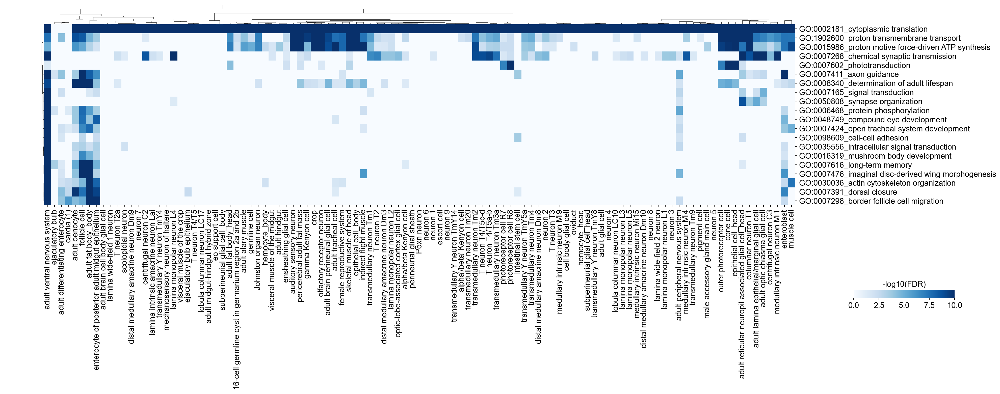

In [94]:
with rc_context({'figure.figsize': (40, 30)}):
    # kws = dict(cbar_kws=dict(ticks=[0, 0.50, 1], orientation='horizontal'), figsize=(6, 6))
    
    kws = dict(cbar_kws=dict(orientation='horizontal'))
    ax=sns.clustermap(goMtxTop_50d, figsize=(25, 10), xticklabels=True, yticklabels=True, cmap='Blues', dendrogram_ratio=(0.05, 0.1),  **kws, vmax=10) # norm=LogNorm(), 
    ax.ax_cbar.set_position((0.85, .25, .1, .02))
    ax.ax_cbar.set_title('-log10(FDR)')
    plt.savefig(f'{goFolder}/heatmap_countHigh_down_eachCelltype_top{goN}_50d_5d.pdf')